<a href="https://colab.research.google.com/github/shirshir05/Project_housing/blob/main/Project_housing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project**

# **Submitted by:** Itai Dagan and Shir Cohen

# **Details of the project**

## **Contribution of each group member**

*   Map Chicago - shir cohen
*   Read data market and visualizing - shir cohen
*   Read data crime and visualizing - itai dagan
*   Get neighborhoods from google API - itai dagan
*   Research Question - Housing market - itai dagan and shir cohen
*   Research Question - Crime - itai dagan and shir cohen
*   Integrating data - itai dagan
*   The impact of crime on the housing market -  itai dagan and shir cohen


## **Data**
We processed data from several sources of information: from the Redfin website and from the Chicago data portal. In addition, we performed geographic data analysis by Google map.

## **Accessibility research of other people/research**
We performed auxiliary functions used in many parts of the code to enable code reuse. In addition, we added documentation in both text and code.



# **Install packge**

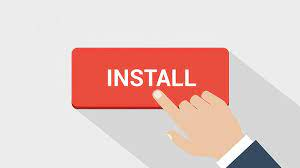

In [2]:
!pip install turicreate
!pip install wikipedia
!pip install pandas fiona shapely pyproj rtree
!pip install geopandas
!pip install -U googlemaps
!pip install cartopy

     |████████████████████████████████| 92.0 MB 13 kB/s 
     |████████████████████████████████| 322 kB 44.5 MB/s 
     |████████████████████████████████| 3.5 MB 20.1 MB/s 
     |████████████████████████████████| 3.6 MB 21.7 MB/s 
     |████████████████████████████████| 86.4 MB 57 kB/s 
     |████████████████████████████████| 18.3 MB 450 kB/s 
     |████████████████████████████████| 449 kB 52.3 MB/s 
     |████████████████████████████████| 3.8 MB 44.9 MB/s 
     |████████████████████████████████| 2.9 MB 51.1 MB/s 
     |████████████████████████████████| 20.1 MB 1.1 MB/s 
     |████████████████████████████████| 50 kB 5.7 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=fc7725cb85879a093f6d678d9ba160b99c806343d659cec0f75620064004d5e2
  Stored in directory: /root/.cache/pip/wheels/b2/7f/f6/f180315b584f00445045ff1699b550fa895d09471337ce21c6
  Created wheel for resampy: filename=resampy-0.2.1-py3-none-any.whl size=320859 sha256=ca016e20eac

  Created wheel for wikipedia: filename=wikipedia-1.4.0-py3-none-any.whl size=11695 sha256=2c9361a4084827a39a31dee2cbfae2b0ad90d92cca245f9a8581120707d4e550
  Stored in directory: /root/.cache/pip/wheels/15/93/6d/5b2c68b8a64c7a7a04947b4ed6d89fb557dcc6bc27d1d7f3ba
Successfully built wikipedia
     |████████████████████████████████| 16.7 MB 5.2 MB/s 
     |████████████████████████████████| 6.3 MB 42.0 MB/s 
     |████████████████████████████████| 994 kB 48.7 MB/s 
     |████████████████████████████████| 1.0 MB 5.0 MB/s 
  Created wheel for googlemaps: filename=googlemaps-4.6.0-py3-none-any.whl size=38554 sha256=6be3b5bdbc30fa1bebed34a20eb0a873154e112c242e648c37ac439aab536ae9
  Stored in directory: /root/.cache/pip/wheels/80/db/c0/6d958585fa97b20e250bf437acf7e6e715b4809c2dd4e55367
Successfully built googlemaps
     |████████████████████████████████| 10.8 MB 5.2 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
     |█████████████████████████████

# **Import**

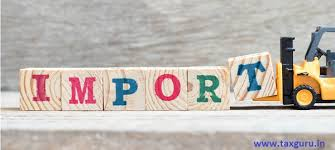

In [3]:
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import os
import csv
import folium
from datetime import datetime
from folium.plugins import TimeSliderChoropleth
import turicreate as tc
from turicreate import SFrame
import tarfile
import pandas as pd
import gzip
import shutil
import geopy
import geopandas as gpd
from google.colab import drive
import os
import csv
import turicreate as tc
from turicreate import SFrame
import tarfile
import pandas as pd
import gzip
import shutil
import geopy
import wikipedia
import matplotlib.pyplot as plt
%matplotlib inline 
from bs4 import BeautifulSoup
import requests
from google.colab import drive
import turicreate.aggregate as agg
import matplotlib.pyplot as plt
import geopandas as gpd
import googlemaps
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.templates.default = "seaborn"
from plotly.subplots import make_subplots
import folium
from folium.plugins import HeatMap
import numpy as np
import networkx as nx

# Configuration

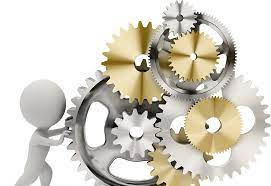

**Define google dribe**

In [4]:
drive.mount('/content/drive')

Mounted at /content/drive


# **Useful function (code reuse)**

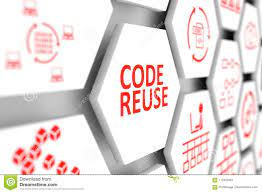

In [7]:
def check_path_existe(path):
  return os.path.exists(os.path.join('content', 'drive', 'Project Housing',path))
    

def remove_columns_one_value(df):
  """ 
  The function removes all columns that contain a single value
  Args: 
      df (sfarme): 

  Returns: new sframe
  """
  def check_len(col_name):
    set_col_name = set(df[col_name])
    if len(set_col_name) == 1:
      print(f"{col_name} remove because  contain only value {set_col_name}")
      return df.remove_column(col_name)
    return df
  for col in df.column_names():
    df = check_len(col)
  return df

def split_column_by_hyphen(df, column_name, delimiter="-"):
  """ 
  The function split column in foramt year-motha-day. 
  The column name remove from the sframe.
  Args: 
      df (sfarme): 
      column_name (str):
      delimiter (str):  
  Returns: new sframe
  """
  df[column_name + "_split"] = df[column_name].apply(lambda x: x.split(delimiter))
  df[column_name + '_year'] = df[column_name + "_split"].apply(lambda x: int(x[0]))
  df[column_name + '_month'] = df[column_name + "_split"].apply(lambda x:  int(x[1]))
  df[column_name + '_day'] = df[column_name + "_split"].apply(lambda x:  int(x[2]))
  df['Date'] = df[column_name].str_to_datetime('%Y-%m-%d')
  df = df.remove_column(column_name)
  df = df.remove_column(column_name + "_split")
  return df

def split_column_by_delimiter(df, column_name, delimiter="/"):
  """ 
  The function split column in foramt day/month/year time. 
  The column name remove from the sframe.
  Args: 
      df (sfarme): 
      column_name (str):
      delimiter (str):  
  Returns: new sframe
  """
  df[column_name + "_split"] = df[column_name].apply(lambda x: x.split(delimiter))
  df[column_name + '_month'] = df[column_name + "_split"].apply(lambda x: int(x[0]))
  df[column_name + '_day'] = df[column_name + "_split"].apply(lambda x:  int(x[1]))
  df[column_name + '_year'] = df[column_name + "_split"].apply(lambda x:  int(x[2].split(" ")[0]))
  df['Date'] = df[column_name].str_to_datetime('%m/%d/%Y, %H:%M:%S')
  df = df.remove_column(column_name)
  df = df.remove_column(column_name + "_split")
  return df


def leave_columns(df, columns_name_leave):
  """ 
  The function gets a sframe and a list of columns to leave. 
  The rest of the columns the function removes from the sfarme. 
  The function returns a new sframe without the removed columns.
  Args: 
      df (sfarme): 
      columns_name_leave (str): 
  Returns: new sframe
  """
  for col in df.column_names():
    if col not in columns_name_leave:
      df = df.remove_column(col)
  return df

def conut_missing_value(df):
  """ 
  The function receives a sframe and for each column returns the number of 
  missing values. The function returns a dictionary that the key is the name 
  of the column and the value is the number of missing values.
  Args: 
      df (sfarme): 
  Returns: dict {'name column' : NUMBER_MISSING_VALUE}
  """
  dict_ = {}
  for col in df.column_names():
    dict_[col] = df[col].countna()
  return dict_

def count_by_col(df, col_name):
  g = df.groupby(col_name, {'Count': agg.COUNT()})
  print(f"Min {col_name}: %s" % g[col_name].min())
  print(f"Max {col_name}: %s"% g[col_name].max())
  print(g.sort("Count", ascending=False))
  plt.bar(g[col_name], list(g['Count']))
  plt.title(f"Count according {col_name}")
  plt.xlabel(col_name)
  plt.ylabel("Count")
  plt.show()
  plt.clf()

def frequencies(df, columns_name):
  """
  Display of words by frequency
  Args: 
      df (sfarme): 
      columns_name (str): 
  """
  g = df.groupby(columns_name,{'Count': agg.COUNT()})
  stopwords = set(STOPWORDS)
  wordcloud = WordCloud(width = 800, height = 800, 
                  background_color ='black', 
                  stopwords = stopwords, 
                  min_font_size = 10)
  wordcloud.generate_from_frequencies(frequencies={r[columns_name]:r['Count'] for r in g})
  plt.figure(figsize = (20, 20), facecolor = None) 
  plt.imshow(wordcloud)

def scatter_plot(df_, column_name_dropdown, columns_name_y, columns_data):
    """
    scatter plot
    Args: 
        df (sfarme): 
        column_name_dropdown (str): 
        columns_name_y(str)
        columns_data(str)
    """
    # column_name_dropdown - neighborhood
    # df_ = df.to_dataframe()
    buttons = []
    i = 0
    fig3 = go.Figure()
    country_list = list(df_[column_name_dropdown].unique())
    for country in country_list:
        fig3.add_trace(
            go.Scatter(
                x = df_[columns_data][df_[column_name_dropdown]==country],
                y = df_[columns_name_y][df_[column_name_dropdown]==country],
                name = country, visible = (i==0)
            )
        )
    for country in country_list:
        args = [False] * len(country_list)
        args[i] = True
        
        #create a button object for the country we are on
        button = dict(label = country,
                      method = "update",
                      args=[{"visible": args}])
        
        #add the button to our list of buttons
        buttons.append(button)
        
        #i is an iterable used to tell our "args" list which value to set to True
        i+=1
        
    fig3.update_layout(updatemenus=[dict(active=0,
                                        type="dropdown",
                                        buttons=buttons,
                                        x = 0,
                                        y = 1.1,
                                        xanchor = 'left',
                                        yanchor = 'bottom'),
                                  ])
    fig3.update_layout(
        autosize=False,
        width=1000,
        height=800,)
    return fig3

def time_plot(date, y_axis, title_text, color='firebrick'):
  # royalblue, 'rgb(204, 204, 204)', 'rgb(82, 82, 82)',
  fig = go.Figure()

  fig.add_trace(
      go.Scatter(x=[i for i in date], y=list(y_axis), line=dict(color=color)))
  fig.update_layout(title_text=title_text)

  fig.update_layout(
      xaxis=dict(rangeselector=dict(buttons=list([dict(count=1,label="1m",
      step="month",stepmode="backward"),dict(count=6,label="6m",step="month",
      stepmode="backward"),dict(count=1,label="YTD",step="year",
      stepmode="todate"),dict(count=1,label="1y",step="year",
      stepmode="backward"),dict(step="all")])),rangeslider=dict(visible=True),
      type="date"))
  fig.show()

# **Motivation**

## **[50% of Homeowners Who Moved Recently Cited Crime as Important Factor](https://https://www.redfin.com/news/survey-half-of-homeowners-who-moved-cited-crime/)**

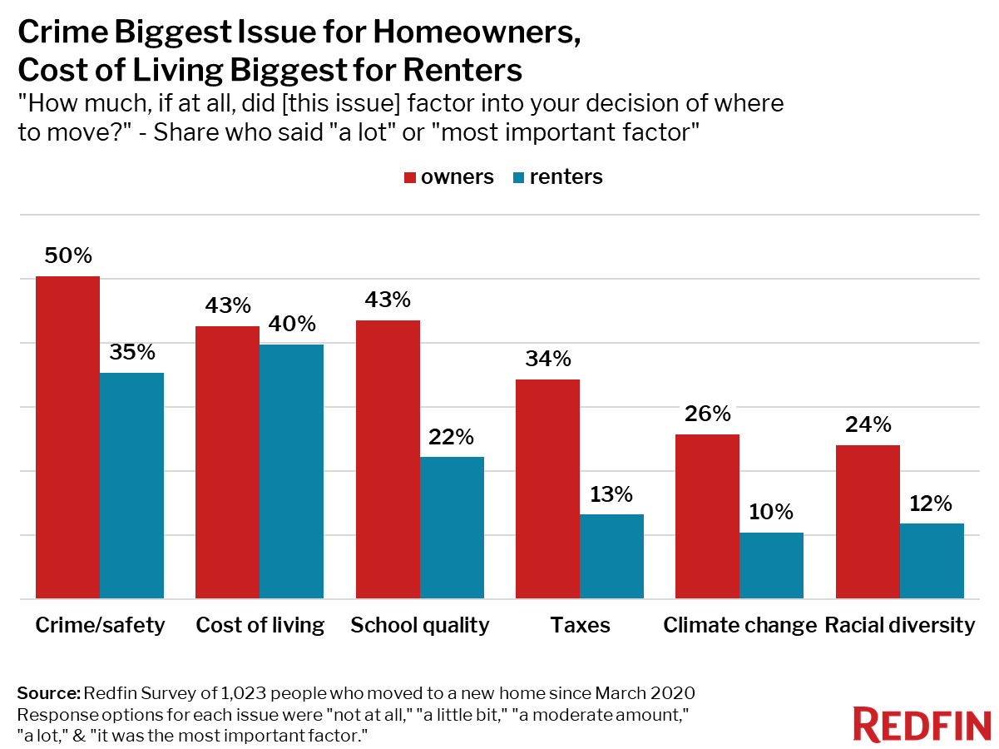

# **Map Chicago**

In [5]:
df_market = pd.read_csv('/content/drive/MyDrive/chicago_market_filtered_with_normalized_neigh.csv')

In [6]:
df_geo = pd.DataFrame(df_market.groupby(['lat', 'lon']).first()['Name'])

In [7]:
m = folium.Map(location=[ 41.8781, -87.6298])
for index, row in df_geo.iterrows():
  if row['Name'] is not None:
    folium.Marker(
      location=index, # coordinates for the marker (Earth Lab at CU Boulder)
      popup="here " + row['Name'], tooltip="Click me!"
      ).add_to(m)
m

In [8]:
m = folium.Map(location=[0,0], zoom_start=2,
               tiles =  'Stamen Terrain')
data = [(index[0],index[1]) for index, row in df_geo.iterrows()]

In [9]:
HeatMap(data, radius = 10).add_to(m)
m

# **Housing Market Data From [Redfin](https://www.redfin.com/news/data-center/)**

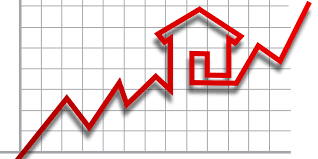

The data of housing market collected from [Redfin website](https://www.redfin.com/news/data-center/). Redfin is a real estate brokerage, meaning they have direct access to data from local multiple listing services, as well as insight from real estate agents across the country. The data organize with several resolution: metropolitan areas, cities, neighborhoods, and zip codes across the nation. We use in data of neighborhoods. Data are presented at 3-month intervals.

## **Step 1** - Read data from file

In the first step of the process, we read the data. The information is stored in a tsv000.gz file. We will extract the information to  tsv000 file and save in SFrame.

In [14]:
if not check_path_existe('df_Chicago.csv'):
  if not os.path.exists('/content/drive/MyDrive/neighborhood_market_tracker.tsv000'):
    with gzip.open('/content/drive/MyDrive/neighborhood_market_tracker.tsv000.gz', 'rb') as f_in:
        with open('/content/drive/MyDrive/neighborhood_market_tracker.tsv000', 'wb') as f_out:
            shutil.copyfileobj(f_in, f_out)
  df = tc.SFrame.read_csv("/content/drive/MyDrive/neighborhood_market_tracker.tsv000", sep='\t')

Finished parsing file /content/drive/MyDrive/neighborhood_market_tracker.tsv000

Parsing completed. Parsed 100 lines in 3.72085 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,int,str,int,int,str,str,str,str,str,str,int,int,float,float,int,float,float,float,float,float,float,float,float,int,float,float,int,float,float,int,float,float,int,float,float,str,str,str,float,float,float,float,float,float,float,float,float,str,str,str,float,float,float,str,int,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 94680 lines. Lines per second: 40986.7

Read 474144 lines. Lines per second: 55320.9

Read 759576 lines. Lines per second: 54923.9

Read 1140619 lines. Lines per second: 56214.2

Read 1427247 lines. Lines per second: 55886.8

Read 1713982 lines. Lines per second: 55258.5

Read 2001095 lines. Lines per second: 54712.2

Read 2288323 lines. Lines per second: 54703.7

Read 2575618 lines. Lines per second: 54063.1

Read 2863230 lines. Lines per second: 53626.5

Read 3151017 lines. Lines per second: 52843.2

Read 3439005 lines. Lines per second: 52008.6

Read 3727130 lines. Lines per second: 51102.9

Read 4015440 lines. Lines per second: 51122.8

Read 4303892 lines. Lines per second: 50479.3

Read 4592423 lines. Lines per second: 50751.9

Read 4880870 lines. Lines per second: 50590.2

Read 5169505 lines. Lines per second: 50872.8

Read 5458189 lines. Lines per second: 50230.3

Read 5746891 lines. Lines per second: 50357.2

Read 6035754 lines. Lines per second: 50445.2

Read 6324697 lines. Lines per second: 50519.3

Read 6613761 lines. Lines per second: 50569.6

Read 6902957 lines. Lines per second: 50627.1

Read 7191925 lines. Lines per second: 50668.8

Read 7481056 lines. Lines per second: 50526.1

Read 7770317 lines. Lines per second: 50506.1

Read 8059204 lines. Lines per second: 50301.7

Read 8348384 lines. Lines per second: 50353.4

Read 8734078 lines. Lines per second: 50738.3

Finished parsing file /content/drive/MyDrive/neighborhood_market_tracker.tsv000

Parsing completed. Parsed 8829270 lines in 172.834 secs.

## **Step 2** - Selection  only Chicago

At this step, we will choose instances that fulfill the following conditions: 
df[df['city'] == 'Chicago']


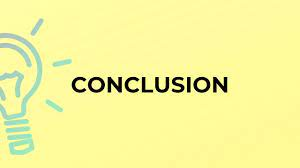

The percentage of reports of the city of Chicago from all data is 0.01


In [15]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago = df[df['city'] == 'Chicago']
  print(df_Chicago.show)

<bound method SFrame.show of Columns:
	period_begin	str
	period_end	str
	period_duration	int
	region_type	str
	region_type_id	int
	table_id	int
	is_seasonally_adjusted	str
	region	str
	city	str
	state	str
	state_code	str
	property_type	str
	property_type_id	int
	median_sale_price	int
	median_sale_price_mom	float
	median_sale_price_yoy	float
	median_list_price	int
	median_list_price_mom	float
	median_list_price_yoy	float
	median_ppsf	float
	median_ppsf_mom	float
	median_ppsf_yoy	float
	median_list_ppsf	float
	median_list_ppsf_mom	float
	median_list_ppsf_yoy	float
	homes_sold	int
	homes_sold_mom	float
	homes_sold_yoy	float
	pending_sales	int
	pending_sales_mom	float
	pending_sales_yoy	float
	new_listings	int
	new_listings_mom	float
	new_listings_yoy	float
	inventory	int
	inventory_mom	float
	inventory_yoy	float
	months_of_supply	str
	months_of_supply_mom	str
	months_of_supply_yoy	str
	median_dom	float
	median_dom_mom	float
	median_dom_yoy	float
	avg_sale_to_list	float
	avg_sale_to_list_m

## **Step 3** -  remove columns with one value

Columns with a single value cannot be used to draw inferences about the data. As a result, we removed such columns.

In [16]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago = remove_columns_one_value(df_Chicago)
  print(df_Chicago.show)


period_duration remove because  contain only value {90}
region_type remove because  contain only value {'neighborhood'}
region_type_id remove because  contain only value {1}
is_seasonally_adjusted remove because  contain only value {'f'}
city remove because  contain only value {'Chicago'}
state remove because  contain only value {'Illinois'}
state_code remove because  contain only value {'IL'}
months_of_supply remove because  contain only value {''}
months_of_supply_mom remove because  contain only value {''}
months_of_supply_yoy remove because  contain only value {''}
price_drops remove because  contain only value {''}
price_drops_mom remove because  contain only value {''}
price_drops_yoy remove because  contain only value {''}
parent_metro_region remove because  contain only value {'Chicago, IL'}
parent_metro_region_metro_code remove because  contain only value {16984}
last_updated remove because  contain only value {'2021-11-21 14:35:51'}
<bound method SFrame.show of Columns:
	peri

## **Step 4** - Removing unnecessary columns

In this step, we defined the column description, an example of the value, and whether or not the column is relevant

In [17]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago.print_rows(num_rows=5, num_columns=41)
  columns_name_leave = ['period_begin', 'period_end', 'region', 'property_type', 'median_list_price', 'homes_sold', 'inventory', 'new_listings', 'median_sale_price']
  df_Chicago = leave_columns(df_Chicago, columns_name_leave)

+--------------+------------+----------+------------------------------+
| period_begin | period_end | table_id |            region            |
+--------------+------------+----------+------------------------------+
|  2014-03-01  | 2014-05-31 |  29339   |     Chicago, IL - Uptown     |
|  2017-11-01  | 2018-01-31 |  555134  |     Chicago, IL - Loyola     |
|  2019-09-01  | 2019-11-30 |  548063  | Chicago, IL - Edgewater Glen |
|  2012-02-01  | 2012-04-30 |  31056   |   Chicago, IL - West Lawn    |
|  2017-09-01  | 2017-11-30 |  31056   |   Chicago, IL - West Lawn    |
+--------------+------------+----------+------------------------------+
+---------------------------+------------------+-------------------+
|       property_type       | property_type_id | median_sale_price |
+---------------------------+------------------+-------------------+
|      All Residential      |        -1        |       252250      |
| Single Family Residential |        6         |       310000      |
|      

In [17]:
if not check_path_existe('df_Chicago.csv'):
  print(df_Chicago.show)

**List of columns after this step in SFrame:**

1.   **period_begin (str)**
      *   Description: Calculated values begin to be  calculated from this date.
      *   Example: '2014-03-01'

2.   **period_end (str)**
      *   Description: Calculated values end to be calculated from this date.
      *   Example: '2014-03-01'
3.   **Region (str)**
      *   Description: region. Contains the name of the state (IL), the city (Chicago) and the neighborhood.
      *   Example: 'Chicago, IL – Uptown'
4. **inventory (int)**
      *   Description: Total number of homes with a listing added date during a given time period.
      *   Example: 5.0	
5.   **property_type (str)**
      *   Description: Type of apartment.
      *   Example: 'All Residential'
6.  **median_list_price (int)**
      *   Description: Description: The most recent listing price covering all homes with a listing date during a given time period where 50% of the active listings were above this price and 50% were below this price.
      *   Example: 250000  
7.  **median_sale_price (int)**
      *   Description: The final home sale price covering all homes with a sale date 	during a given time period where 50% of the sales were above this price and 	50% were below this price.
      *   Example: 252250 
8.  **homes_sold (int)**
      *   Description: Total homes sold
      *   Example: 228    	 	
9.  **new_listings (int)**
      *   Description: Total number of homes with a listing added date during a given time period.
      *   Example: 8   	

## **Step 5** - Handle missing values

First, we will count the number of missing values in each column to determine how to handle the missing data.
We decided to remove all the rows that include missing values since the number of missing values is insignificant in comparison to the number of rows.


In [18]:
if not check_path_existe('df_Chicago.csv'):
  print(conut_missing_value(df_Chicago))

{'period_begin': 0, 'period_end': 0, 'region': 0, 'property_type': 0, 'median_sale_price': 0, 'median_list_price': 6364, 'homes_sold': 0, 'new_listings': 6329, 'inventory': 8123}


In [19]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago = df_Chicago.dropna()

In [20]:
if not check_path_existe('df_Chicago.csv'):
   print(df_Chicago.show)

<bound method SFrame.show of Columns:
	period_begin	str
	period_end	str
	region	str
	property_type	str
	median_sale_price	int
	median_list_price	int
	homes_sold	int
	new_listings	int
	inventory	int

Rows: Unknown

Data:
+--------------+------------+------------------------------+
| period_begin | period_end |            region            |
+--------------+------------+------------------------------+
|  2014-03-01  | 2014-05-31 |     Chicago, IL - Uptown     |
|  2017-11-01  | 2018-01-31 |     Chicago, IL - Loyola     |
|  2019-09-01  | 2019-11-30 | Chicago, IL - Edgewater Glen |
|  2012-02-01  | 2012-04-30 |   Chicago, IL - West Lawn    |
|  2018-10-01  | 2018-12-31 | Chicago, IL - Palmer Square  |
|  2014-04-01  | 2014-06-30 |    Chicago, IL - Avondale    |
|  2015-11-01  | 2016-01-31 |     Chicago, IL - Austin     |
|  2014-06-01  | 2014-08-31 |    Chicago, IL - New City    |
|  2019-03-01  | 2019-05-31 |   Chicago, IL - Sheffield    |
|  2016-12-01  | 2017-02-28 |   Chicago, IL - We

## **Step 6** - Manipulation on columns

### **Data period**

The data of 'period_begin' and 'period_end' columns write in format 'year-month-day' e.g: 2014-03-01. We extract each value to another columns ('year', 'month', 'day') and remove the 'period_begin' and 'period_end' columns.

In [21]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago = split_column_by_hyphen(df_Chicago, 'period_begin')
  df_Chicago = split_column_by_hyphen(df_Chicago, 'period_end')

In [22]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago.show

### **Region** 

The region column contains the name of the state (IL), the city (Chicago) and the neighborhood. e.g 'Chicago, IL – Uptown'. We extract only the neighborhood name and remove the region column.  

In [23]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago['neighborhood'] = df_Chicago['region'].apply(lambda s: s.split("IL -")[1])
  df_Chicago = df_Chicago.remove_column('region')

In [24]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago.groupby("neighborhood",{'count':tc.aggregate.COUNT()}).export_csv("neighborhood.csv")

## **Save data after preprocessing**

In [25]:
if not check_path_existe('df_Chicago.csv'):
  df_Chicago.export_csv(os.path.join('drive', 'MyDrive', 'df_Chicago_processed.csv'))

## **Visualizing data**

After the data processing step, we will want to visualize the data.

In [26]:
df_Chicago.show()

Materializing SFrame

Warning: Skipping column 'Date'. Unable to show columns of type 'datetime'; only [int, float, str] can be shown.

Further warnings of unsupported type will be suppressed.

***The property type column has 5 unique values:***
•	All residential
•	Single Family Residential
•	Condo/Co-op
•	Townhouse
•	Multi-Family (2-4 Unit)
The most common value is All residential.


***Year***
The number of rows is the same between the years (since there is a three-month difference between each row). In 2021 we see a slight decrease in the number of rows because data were extracted until November.

***Median sale price***
The max value: 7500000$
The mean value: 317.624 $
The min value: 1$



### **period_begin_year**

Min period_begin_year: 2012
Max period_begin_year: 2021
+-------------------+-------+
| period_begin_year | Count |
+-------------------+-------+
|        2012       |  9522 |
|        2014       |  9514 |
|        2013       |  9507 |
|        2015       |  9419 |
|        2016       |  9409 |
|        2017       |  9306 |
|        2018       |  9171 |
|        2019       |  9117 |
|        2020       |  9003 |
|        2021       |  6182 |
+-------------------+-------+
[10 rows x 2 columns]



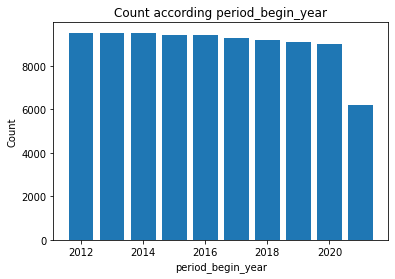

<Figure size 432x288 with 0 Axes>

In [27]:
count_by_col(df_Chicago, "period_begin_year")

### **homes_sold**

Min homes_sold: 1
Max homes_sold: 2599
+------------+-------+
| homes_sold | Count |
+------------+-------+
|     1      |  8989 |
|     2      |  6969 |
|     3      |  5681 |
|     4      |  4867 |
|     5      |  4030 |
|     6      |  3378 |
|     7      |  2992 |
|     8      |  2640 |
|     9      |  2386 |
|     10     |  2143 |
+------------+-------+
[1443 rows x 2 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


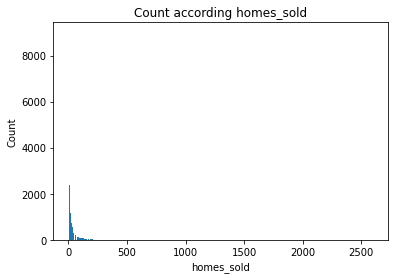

<Figure size 432x288 with 0 Axes>

In [28]:
count_by_col(df_Chicago, "homes_sold")

# **Crime data from [Chicago data portal](https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present/ijzp-q8t2/data)**

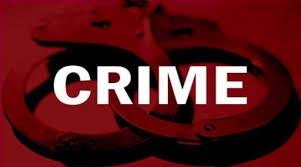

## **Step 1** - Read data from file

The data of crime collected from [Chicago data portal](https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present/ijzp-q8t2/data). This dataset reflects reported incidents of crime (with the exception of murders where data exists for each victim) that occurred in the City of Chicago from 2001 to December 2021. Data is extracted from the Chicago Police Department's CLEAR (Citizen Law Enforcement Analysis and Reporting) system.

In the first step of the process, we read the data. The information is stored in a csv file and we save it in SFrame.

In [29]:
df_crime = tc.SFrame.read_csv('/content/drive/MyDrive/Crimes_-_2001_to_Present.csv')

Finished parsing file /content/drive/MyDrive/Crimes_-_2001_to_Present.csv

Parsing completed. Parsed 100 lines in 4.1311 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,str,str,str,str,str,str,int,int,int,int,str,int,int,int,str,float,float,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 220515 lines. Lines per second: 93354.6

Read 1103036 lines. Lines per second: 124354

Read 1784618 lines. Lines per second: 128326

Read 2450169 lines. Lines per second: 122381

Read 3114084 lines. Lines per second: 124032

Read 3777875 lines. Lines per second: 124741

Read 4441879 lines. Lines per second: 125204

Read 5106109 lines. Lines per second: 125352

Read 5769303 lines. Lines per second: 123167

Read 6216958 lines. Lines per second: 115724

Read 6879745 lines. Lines per second: 117033

Finished parsing file /content/drive/MyDrive/Crimes_-_2001_to_Present.csv

Parsing completed. Parsed 7450360 lines in 61.5127 secs.

## **Step 2** - remove columns with one value

There were no columns with a single value.

In [30]:
df_crime = remove_columns_one_value(df_crime)
df_crime.show

<bound method SFrame.show of Columns:
	ID	int
	Case Number	str
	Date	str
	Block	str
	IUCR	str
	Primary Type	str
	Description	str
	Location Description	str
	Arrest	str
	Domestic	str
	Beat	int
	District	int
	Ward	int
	Community Area	int
	FBI Code	str
	X Coordinate	int
	Y Coordinate	int
	Year	int
	Updated On	str
	Latitude	float
	Longitude	float
	Location	str

Rows: 7450360

Data:
+----------+-------------+------------------------+-------------------------+
|    ID    | Case Number |          Date          |          Block          |
+----------+-------------+------------------------+-------------------------+
| 10224738 |   HY411648  | 09/05/2015 01:30:00 PM |     043XX S WOOD ST     |
| 10224739 |   HY411615  | 09/04/2015 11:30:00 AM |   008XX N CENTRAL AVE   |
| 11646166 |   JC213529  | 09/01/2018 12:01:00 AM |  082XX S INGLESIDE AVE  |
| 10224740 |   HY411595  | 09/05/2015 12:45:00 PM |    035XX W BARRY AVE    |
| 10224741 |   HY411610  | 09/05/2015 01:00:00 PM |   0000X N LARAMIE AVE 

## **Step 3** - Removing unnecessary columns

In this step, we defined the column description, an example of the value, and whether or not the column is relevant. A list with the description of the columns is shown in Appendix 3.

In [31]:
columns_name_leave = ['Date', 'Primary Type', 'Description', 
    'Location Description', 'Arrest', 'Latitude', 'Longitude']
df_crime = leave_columns(df_crime, columns_name_leave)

In [32]:
df_crime.show

<bound method SFrame.show of Columns:
	Date	str
	Primary Type	str
	Description	str
	Location Description	str
	Arrest	str
	Latitude	float
	Longitude	float

Rows: 7450360

Data:
+------------------------+--------------------+-------------------------------+
|          Date          |    Primary Type    |          Description          |
+------------------------+--------------------+-------------------------------+
| 09/05/2015 01:30:00 PM |      BATTERY       |    DOMESTIC BATTERY SIMPLE    |
| 09/04/2015 11:30:00 AM |       THEFT        |         POCKET-PICKING        |
| 09/01/2018 12:01:00 AM |       THEFT        |           OVER $500           |
| 09/05/2015 12:45:00 PM |     NARCOTICS      |     POSS: HEROIN(BRN/TAN)     |
| 09/05/2015 01:00:00 PM |      ASSAULT       |             SIMPLE            |
| 09/05/2015 10:55:00 AM |      BURGLARY      |         FORCIBLE ENTRY        |
| 09/04/2015 06:00:00 PM |      BURGLARY      |         UNLAWFUL ENTRY        |
| 09/05/2015 01:00:00 PM

***List of columns after this step in SFrame:***


1.	Date (str)

    1.1.	Description: Date when the incident occurred. this is sometimes a best estimate.
    
    1.2.	Example:  09/05/2015 01:30:00 PM  
2.	Primary Type (str)
    
    2.1.	Description: The primary description of the IUCR code. 
    
    2.2.	Example:  BATTERY       
3.	Description (str)
    
    3.1.	Description: The secondary description of the IUCR code, a subcategory of the primary description.
    
    3.2.	Example:  POCKET-PICKING       
4.	Location Description (str)
    
    4.1.	Description: Description of the location where the incident occurred.
    
    4.2.	Example:  RESIDENCE              
5.	Arrest (str)
    
    5.1.	Description: Indicates whether an arrest was made.
    
    5.2.	Example:  false              
6.	Latitude (float)
    
    6.1.	Description: The latitude of the location where the incident occurred. This 	location is shifted from the actual location for partial redaction but falls on 	the same block.
    
    6.2.	Example:  41.815117282  
    
    6.3.	Removal reason: unnecessary value.   
7.	Longitude (float)
    
    7.1.	Description: 	The longitude of the location where the incident occurred. 	This location is shifted from the actual location for partial redaction but falls 	on the same block.
    
    7.2.	Example:  -87.669999562  
    
    7.3.	Removal reason: unnecessary value.   


## **Step 4** – Handle missing values

First, we will count the number of missing values in each column to determine how to handle the missing data. 
We decided to remove all the rows that include missing values since the number of missing values is insignificant in comparison to the number of rows.


In [33]:
conut_missing_value(df_crime)

{'Arrest': 0,
 'Date': 0,
 'Description': 0,
 'Latitude': 74925,
 'Location Description': 0,
 'Longitude': 74925,
 'Primary Type': 0}

In [34]:
df_crime = df_crime.dropna()
df_crime.show

<bound method SFrame.show of Columns:
	Date	str
	Primary Type	str
	Description	str
	Location Description	str
	Arrest	str
	Latitude	float
	Longitude	float

Rows: Unknown

Data:
+------------------------+--------------+-------------------------+
|          Date          | Primary Type |       Description       |
+------------------------+--------------+-------------------------+
| 09/05/2015 01:30:00 PM |   BATTERY    | DOMESTIC BATTERY SIMPLE |
| 09/04/2015 11:30:00 AM |    THEFT     |      POCKET-PICKING     |
| 09/05/2015 12:45:00 PM |  NARCOTICS   |  POSS: HEROIN(BRN/TAN)  |
| 09/05/2015 01:00:00 PM |   ASSAULT    |          SIMPLE         |
| 09/05/2015 10:55:00 AM |   BURGLARY   |      FORCIBLE ENTRY     |
| 09/04/2015 06:00:00 PM |   BURGLARY   |      UNLAWFUL ENTRY     |
| 09/05/2015 01:00:00 PM |    THEFT     |       RETAIL THEFT      |
| 09/05/2015 11:30:00 AM |   ROBBERY    |  STRONGARM - NO WEAPON  |
| 09/05/2015 02:00:00 PM |    THEFT     |      $500 AND UNDER     |
| 09/05/

## **Step 5** – Manipulation on columns

The data of 'Date' column write in format ' day/month/year time' e.g: 09/05/2015 01:30:00 PM. We extract each value to another columns ('year', 'month', 'day') and remove the 'Date' column.

In [35]:
df_crime = split_column_by_delimiter(df_crime, 'Date', delimiter="/")

In [36]:
df_crime.show

<bound method SFrame.show of Columns:
	Primary Type	str
	Description	str
	Location Description	str
	Arrest	str
	Latitude	float
	Longitude	float
	Date_month	int
	Date_day	int
	Date_year	int

Rows: 7375435

Data:
+--------------+-------------------------+--------------------------------+
| Primary Type |       Description       |      Location Description      |
+--------------+-------------------------+--------------------------------+
|   BATTERY    | DOMESTIC BATTERY SIMPLE |           RESIDENCE            |
|    THEFT     |      POCKET-PICKING     |            CTA BUS             |
|  NARCOTICS   |  POSS: HEROIN(BRN/TAN)  |            SIDEWALK            |
|   ASSAULT    |          SIMPLE         |           APARTMENT            |
|   BURGLARY   |      FORCIBLE ENTRY     |           RESIDENCE            |
|   BURGLARY   |      UNLAWFUL ENTRY     |        RESIDENCE-GARAGE        |
|    THEFT     |       RETAIL THEFT      |       GROCERY FOOD STORE       |
|   ROBBERY    |  STRONGARM -

## **Visualization data**

In [37]:
df_crime.show()

Materializing SFrame

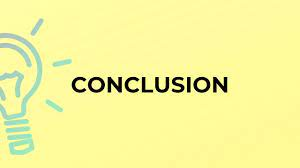



*   Only 0.36 percentage of the crimes ended with arrest of the 
*   Over the years there has been a declining in crime.

suspects. 

### **Primary Type**

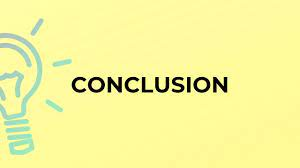

There are 36 types of crimes. The most common crime is theft and battery.

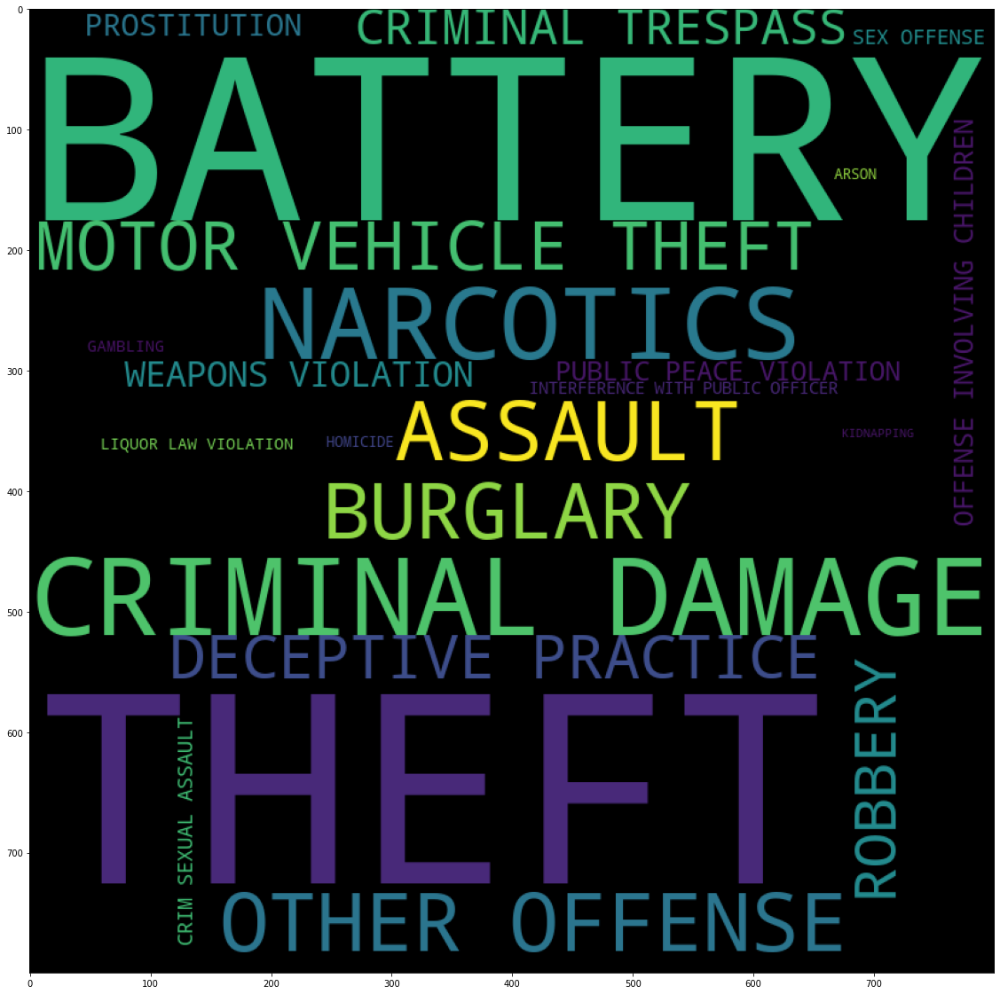

In [38]:
frequencies(df_crime, 'Primary Type')

### **Location Description**

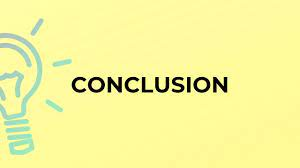


The most common location where the incident occurred was in the street. 

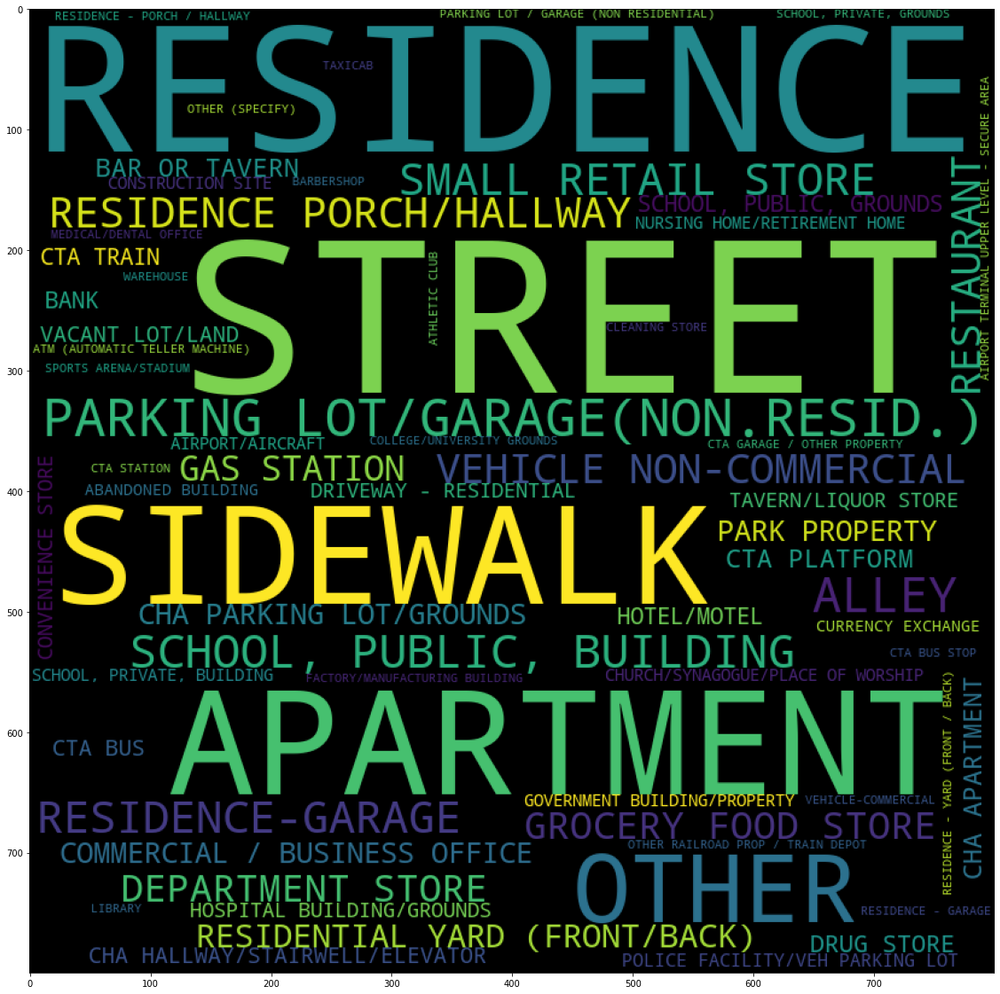

In [39]:
frequencies(df_crime, 'Location Description')

### **Description**

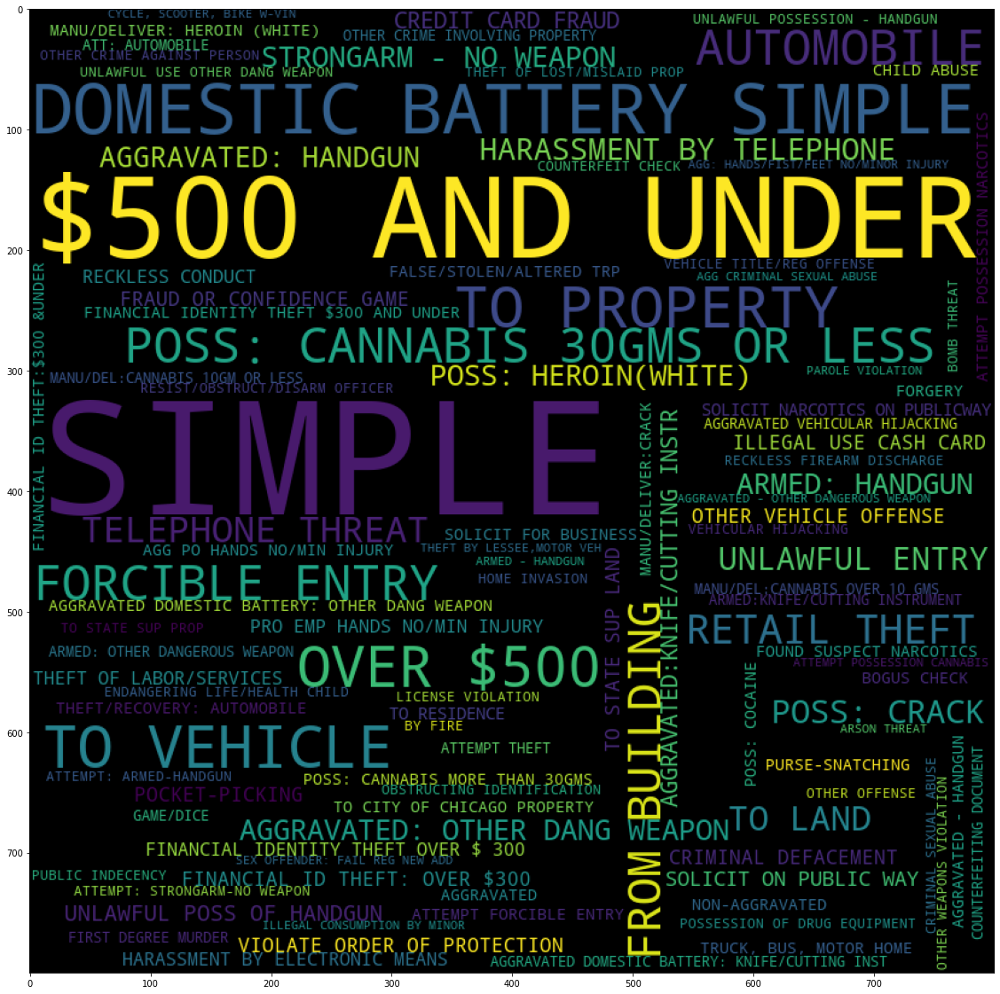

In [41]:
frequencies(df_crime, 'Description')

### **Date**

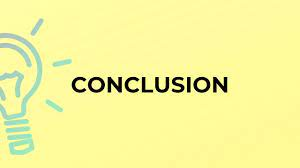

1.   Over the years there has been a declining in crime.

2.   As the crime is greater at the beginning of the month than the other days of the month. Let us note that the 31st of the month does not always occur, thus the amount of crime is lower.
3. There is no discernible trend in crime based on the months of the year.



Min Date_year: 2001
Max Date_year: 2021
+-----------+--------+
| Date_year | Count  |
+-----------+--------+
|    2001   | 482877 |
|    2003   | 472038 |
|    2002   | 471529 |
|    2004   | 467203 |
|    2005   | 449920 |
|    2006   | 445547 |
|    2007   | 435693 |
|    2008   | 420033 |
|    2009   | 386047 |
|    2010   | 370006 |
+-----------+--------+
[21 rows x 2 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


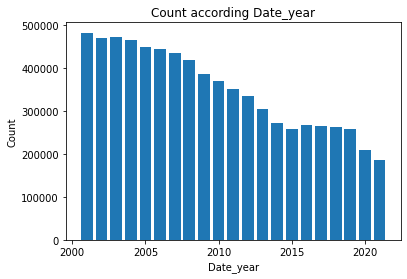

<Figure size 432x288 with 0 Axes>

In [42]:
count_by_col(df_crime, "Date_year")

Min Date_day: 1
Max Date_day: 31
+----------+--------+
| Date_day | Count  |
+----------+--------+
|    1     | 281861 |
|    15    | 250052 |
|    20    | 246401 |
|    10    | 243996 |
|    17    | 243033 |
|    14    | 242656 |
|    16    | 242371 |
|    12    | 241594 |
|    21    | 241479 |
|    18    | 241220 |
+----------+--------+
[31 rows x 2 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


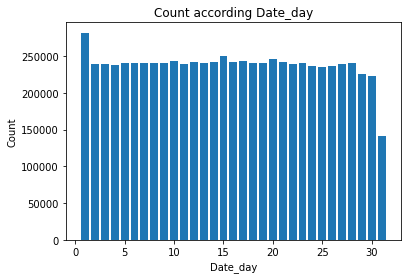

<Figure size 432x288 with 0 Axes>

In [43]:
count_by_col(df_crime, "Date_day")

Min Date_month: 1
Max Date_month: 12
+------------+--------+
| Date_month | Count  |
+------------+--------+
|     7      | 688626 |
|     8      | 681166 |
|     5      | 657752 |
|     6      | 654665 |
|     10     | 645010 |
|     9      | 639506 |
|     3      | 605270 |
|     4      | 603027 |
|     11     | 580015 |
|     1      | 576178 |
+------------+--------+
[12 rows x 2 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns.


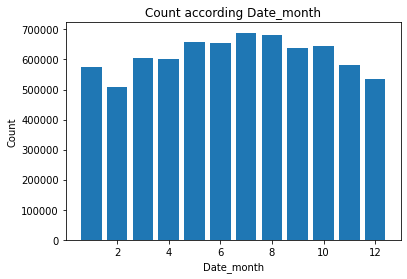

<Figure size 432x288 with 0 Axes>

In [44]:
count_by_col(df_crime, "Date_month")

# **Get neighborhoods**

We decided focus on neighborhoods level in chicago, however we have 2 datasets from different sources that can't be joined without manipulating them.

Therefore, we have to do the following:


1.   **Crime dataset** -
      
  Our geo location data is per record we have it's coordinates of where the crime happened, therefore we will need to give each record in which neighborhood it happened.

  We will do it by using ***point in polygon*** - by merging the Chicago neighborhoods KML file that contatins polygons of the neighborhoods with the data we have and then we will get the relevant neighborhood name as mentioned in the KML file.

2.   **Market dataset** - 

  Our resoulution here is the neighborhood name, but it doesn't match the same name as the names in the KML file. 
  
  We thought a lot on how to get the same name for both of them and then we came up with an idea of using **Google Maps API** to get the coordinates of the neighborhood name from the market dataset, and then we will be able to perform point in polygon as we did in the crime dataset.

Eventually, we have for each record his neighborhood name in the same format so later on we will be able to perform analysis over the data.




In [45]:
neigh = False
if os.path.exists('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv'):
  df_crime = pd.read_csv('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv')
  df_Chicago = pd.read_csv('/content/drive/MyDrive/chicago_market_filtered_with_normalized_neigh.csv')
  neigh = True

## Generating normalized neighborhoods for crime dataset

In [46]:
neigh = False

In [55]:
if not neigh:
  # Taking data from 2015
  sf_chicago_crime_filtered = df_crime[df_crime['Date_year'] >= 2015] 
  # Ignoring data that doesn't have geographic information
  sf_chicago_crime_filtered = sf_chicago_crime_filtered.dropna(subset=['Latitude'])

In [56]:
if not neigh:
  #enable the read and write functionalities for KML-driver
  gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'

  # Filepath to KML file
  fp = '/content/drive/MyDrive/Chicago_Neighborhoods.kml'

  #import into a geoDataFrame
  chicago_neigh_kml = gpd.read_file(fp, driver='KML')
  chicago_neigh_kml.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 228 entries, 0 to 227
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   Name         228 non-null    object  
 1   Description  228 non-null    object  
 2   geometry     228 non-null    geometry
dtypes: geometry(1), object(2)
memory usage: 5.5+ KB


In [57]:
if not neigh:
  chicago_neigh_kml.head(2)

In [58]:
if not neigh:
  #changing the crime dataset into a GeoDataFrame to create geometry series
  chicago_crime_gdf = gpd.GeoDataFrame(sf_chicago_crime_filtered, geometry=gpd.points_from_xy(sf_chicago_crime_filtered['Longitude'],sf_chicago_crime_filtered['Latitude']))

  chicago_crime_gdf.head()

In order to match between the crimes and the neighborhoods we will use left join to find in which polygon the crime falls

In [69]:
chicago_crime_gdf.rename(columns={'index_right': 'index_right_1'}, inplace=True)

In [70]:
if not neigh:
  # Point in polygon
  chicago_crime_gdf_with_neigh = chicago_crime_gdf.sjoin(chicago_neigh_kml,how='left',op='within')
  chicago_crime_gdf_with_neigh = chicago_crime_gdf_with_neigh.drop(columns=['Description_right'])
  chicago_crime_gdf_with_neigh.to_csv('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1938: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  return geopandas.sjoin(left_df=self, right_df=df, *args, **kwargs)


KeyError: ignored

## Generating normalized neighborhoods for market dataset

In [ ]:
if not neigh:
  neighboords= pd.read_csv("/content/drive/MyDrive/neighborhood.csv")
  neighboords.head()

In [ ]:
if not neigh:
  # Need to put key if needed
  gmaps = googlemaps.Client(key='xxxxxxxxxxx')

In [ ]:
if not neigh:
  def get_neighbourhood(neigh_name):
    try:
      placeGeo = gmaps.geocode(f"Chicago, IL - {neigh_name}")
      lat = placeGeo[0].get("geometry").get("location").get("lat")
      lon = placeGeo[0].get("geometry").get("location").get("lng")
      return lat,lon
    except Exception as e:
      return None, None

In [ ]:
if not neigh:
  neighboords["coordinates"] = neighboords["neighborhood"].apply(get_neighbourhood)

In [ ]:
if not neigh:
  coordinate_columns = pd.DataFrame.from_records(data, columns=['lat', 'lon'])
  coordinate_columns.head()

In [ ]:
if not neigh:
  result = pd.concat([neighboords, coordinate_columns], axis=1)
  result.head()

In [ ]:
if not neigh:
  #changing to a GeoDataFrame to create geometry series
  market_neighboords_gdf = gpd.GeoDataFrame(result, geometry=gpd.points_from_xy(result['lon'],result['lat']))

  market_neighboords_gdf.head()

In [ ]:
if not neigh:
  market_neighboors_mapping = market_neighboords_gdf.sjoin(chicago_neigh_kml,how='left',op='within')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: FutureWarning:

The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.

/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1938: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326




In [ ]:
if not neigh:
  market_neighboors_mapping.to_csv('/content/drive/MyDrive/market_neighborods_with_common_names.csv')

In [ ]:
if not neigh:
  pd_df_chicago = df_Chicago.to_dataframe()
  market_merged = pd.merge(pd_df_chicago, market_neighboors_mapping, how="left", left_on='neighborhood', right_on='neighborhood')
  market_merged.to_csv('/content/drive/MyDrive/chicago_market_filtered_with_normalized_neigh.csv')

In [ ]:
market_merged.head()

,property_type,median_sale_price,median_list_price,homes_sold,new_listings,inventory,period_begin_year,period_begin_month,period_begin_day,Date,period_end_year,period_end_month,period_end_day,neighborhood,Unnamed: 0,count,lat,lon,geometry,index_right,Name,Description
0,All Residential,252250,250000,228,433,326,2014,3,1,2014-05-31,2014,5,31,Uptown,42,478,41.966540,-87.653340,POINT (-87.6533404 41.9665404),147.0,Uptown,Wikipedia (http://en.wikipedia.org/wiki/Uptown...
1,Single Family Residential,310000,377450,11,4,3,2017,11,1,2018-01-31,2018,1,31,Loyola,107,466,41.998948,-87.658259,POINT (-87.65825919999999 41.9989483),201.0,Rogers Park,Wikipedia (http://en.wikipedia.org/wiki/Rogers...
2,All Residential,544500,424500,6,9,8,2019,9,1,2019-11-30,2019,11,30,Edgewater Glen,43,312,41.993025,-87.665354,POINT (-87.6653544 41.9930252),177.0,Edgewater Glen,Wikipedia (http://en.wikipedia.org/wiki/Edgewa...
3,All Residential,119000,118500,80,133,134,2012,2,1,2012-04-30,2012,4,30,West Lawn,251,401,41.778663,-87.722794,POINT (-87.7227942 41.7786631),158.0,West Lawn,Wikipedia (http://en.wikipedia.org/wiki/West_L...
4,Condo/Co-op,363750,370000,12,8,7,2018,10,1,2018-12-31,2018,12,31,Palmer Square,78,295,41.921070,-87.700482,POINT (-87.70048229999999 41.9210705),6.0,Palmer Square,Wikipedia (http://en.wikipedia.org/wiki/Palmer...


In [ ]:
chicago_crime_gdf_with_neigh.head()

,Primary Type,Description_left,Location Description,Arrest,Latitude,Longitude,Date_month,Date_day,Date_year,geometry,index_right,Name
0,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,false,41.815117,-87.670000,9,5,2015,POINT (-87.67000 41.81512),222.0,Back of the Yards
1,THEFT,POCKET-PICKING,CTA BUS,false,41.895080,-87.765400,9,4,2015,POINT (-87.76540 41.89508),210.0,South Austin
2,NARCOTICS,POSS: HEROIN(BRN/TAN),SIDEWALK,true,41.937406,-87.716650,9,5,2015,POINT (-87.71665 41.93741),4.0,Logan Square
3,ASSAULT,SIMPLE,APARTMENT,false,41.881903,-87.755121,9,5,2015,POINT (-87.75512 41.88190),210.0,South Austin
4,BURGLARY,FORCIBLE ENTRY,RESIDENCE,false,41.744379,-87.658431,9,5,2015,POINT (-87.65843 41.74438),167.0,Gresham


In [ ]:
chicago_crime_gdf_with_neigh_  = pd.concat([chicago_crime_gdf_with_neigh, pd.get_dummies(chicago_crime_gdf_with_neigh['Primary Type'],  prefix='Primary Type'), pd.get_dummies(chicago_crime_gdf_with_neigh['Arrest'],  prefix='Arrest')], axis=1)


In [ ]:
chicago_crime_gdf_with_neigh_.head()

,Primary Type,Description_left,Location Description,Arrest,Latitude,Longitude,Date_month,Date_day,Date_year,geometry,index_right,Name,Primary Type_ARSON,Primary Type_ASSAULT,Primary Type_BATTERY,Primary Type_BURGLARY,Primary Type_CONCEALED CARRY LICENSE VIOLATION,Primary Type_CRIM SEXUAL ASSAULT,Primary Type_CRIMINAL DAMAGE,Primary Type_CRIMINAL SEXUAL ASSAULT,Primary Type_CRIMINAL TRESPASS,Primary Type_DECEPTIVE PRACTICE,Primary Type_GAMBLING,Primary Type_HOMICIDE,Primary Type_HUMAN TRAFFICKING,Primary Type_INTERFERENCE WITH PUBLIC OFFICER,Primary Type_INTIMIDATION,Primary Type_KIDNAPPING,Primary Type_LIQUOR LAW VIOLATION,Primary Type_MOTOR VEHICLE THEFT,Primary Type_NARCOTICS,Primary Type_NON - CRIMINAL,Primary Type_NON-CRIMINAL,Primary Type_NON-CRIMINAL (SUBJECT SPECIFIED),Primary Type_OBSCENITY,Primary Type_OFFENSE INVOLVING CHILDREN,Primary Type_OTHER NARCOTIC VIOLATION,Primary Type_OTHER OFFENSE,Primary Type_PROSTITUTION,Primary Type_PUBLIC INDECENCY,Primary Type_PUBLIC PEACE VIOLATION,Primary Type_RITUALISM,Primary Type_ROBBERY,Primary Type_SEX OFFENSE,Primary Type_STALKING,Primary Type_THEFT,Primary Type_WEAPONS VIOLATION,Arrest_false,Arrest_true
0,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,false,41.815117,-87.670000,9,5,2015,POINT (-87.67000 41.81512),222.0,Back of the Yards,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,THEFT,POCKET-PICKING,CTA BUS,false,41.895080,-87.765400,9,4,2015,POINT (-87.76540 41.89508),210.0,South Austin,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
2,NARCOTICS,POSS: HEROIN(BRN/TAN),SIDEWALK,true,41.937406,-87.716650,9,5,2015,POINT (-87.71665 41.93741),4.0,Logan Square,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,ASSAULT,SIMPLE,APARTMENT,false,41.881903,-87.755121,9,5,2015,POINT (-87.75512 41.88190),210.0,South Austin,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,BURGLARY,FORCIBLE ENTRY,RESIDENCE,false,41.744379,-87.658431,9,5,2015,POINT (-87.65843 41.74438),167.0,Gresham,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [ ]:
chicago_crime_gdf_with_neigh_

In [ ]:
operations_dict = {'Description_left':' | '.join}
for column in chicago_crime_gdf_with_neigh_.columns:
  if column.startswith('Primary Type_') or column.startswith('Arrest_'):
    operations_dict[column] = 'sum'

In [ ]:
grouped = chicago_crime_gdf_with_neigh_.groupby(['Name', 'Date_year', 'Date_month']).agg(operations_dict)

# **Research Question - Housing market**

In [71]:
df_Chicago.dropna(inplace=True)
df_Chicago = df_Chicago[df_Chicago['period_begin_year'] >= 2015]
df_Chicago.head()

,Unnamed: 0,property_type,median_sale_price,median_list_price,homes_sold,new_listings,inventory,period_begin_year,period_begin_month,period_begin_day,Date,period_end_year,period_end_month,period_end_day,neighborhood,Unnamed: 0.1,count,lat,lon,geometry,index_right,Name,Description
1,1,Single Family Residential,310000,377450,11,4,3,2017,11,1,2018-01-31,2018,1,31,Loyola,107,466,41.998948,-87.658259,POINT (-87.65825919999999 41.9989483),201.0,Rogers Park,Wikipedia (http://en.wikipedia.org/wiki/Rogers...
2,2,All Residential,544500,424500,6,9,8,2019,9,1,2019-11-30,2019,11,30,Edgewater Glen,43,312,41.993025,-87.665354,POINT (-87.6653544 41.9930252),177.0,Edgewater Glen,Wikipedia (http://en.wikipedia.org/wiki/Edgewa...
4,4,Condo/Co-op,363750,370000,12,8,7,2018,10,1,2018-12-31,2018,12,31,Palmer Square,78,295,41.921070,-87.700482,POINT (-87.70048229999999 41.9210705),6.0,Palmer Square,Wikipedia (http://en.wikipedia.org/wiki/Palmer...
6,6,Single Family Residential,90750,101900,82,83,108,2015,11,1,2016-01-31,2016,1,31,Austin,114,561,41.894871,-87.765401,POINT (-87.7654014 41.8948712),210.0,South Austin,Wikipedia (http://en.wikipedia.org/wiki/South_...
8,8,Townhouse,725000,672000,5,6,7,2019,3,1,2019-05-31,2019,5,31,Sheffield,147,484,41.931222,-87.653811,POINT (-87.65381060000001 41.9312218),170.0,Wrightwood Neighbors,Wikipedia (http://en.wikipedia.org/wiki/Wright...


In [72]:
def create_data_columns(df, column_name):
  df['Date'] = df['period_begin_month'].astype(str) + "/" + df[column_name + '_day'].astype(str) + "/" + df[column_name + '_year'].astype(str) 
  df['Date'] = pd.to_datetime(df['Date'])
if 'Date' not in list(df_Chicago.columns):
  create_data_columns(df_Chicago, 'period_begin') #

[Link](https://towardsdatascience.com/top-4-python-libraries-to-build-interactive-timeseries-plots-f2214cc9b1ea)   [link 2](https://www.analyticsvidhya.com/blog/2021/10/interactive-plots-in-python-with-plotly-a-complete-guide/)

## **Date**

### **homes_sold and property_type**

In [73]:
fig = px.scatter(df_Chicago, x="Date", y="homes_sold", color='property_type')
fig.show()

### **Count insatnce pre property_type**

In [74]:
g  = pd.DataFrame(df_Chicago.groupby('property_type').size(), columns=["Count"])
g['property_type'] = g.index
fig = px.pie(g, values='Count', names='property_type', title='Count insatnce pre property_type',color_discrete_sequence=px.colors.sequential.RdBu )
fig.show()

In [75]:
pd.DataFrame(g, columns=["Count"])

,Count
property_type,
All Residential,19674
Condo/Co-op,13284
Multi-Family (2-4 Unit),3668
Single Family Residential,16161
Townhouse,7326


In [76]:
# fig = px.line(df_Chicago, x='Date', y="homes_sold", color='neighborhood')
# fig.show()

In [77]:
fig = px.bar(df_Chicago, x="neighborhood", y="homes_sold")
fig.show()

In [160]:
g  = pd.DataFrame(df_Chicago.groupby('neighborhood').size(), columns=["Count"])
g['neighborhood'] = g.index
g = pd.DataFrame.from_dict({i['neighborhood'] :i['Count'] for index, i in g.iterrows() if i['Count'] > 500}, orient='index')
g['neighborhood'] = g.index
fig = px.pie(g, values=0, names='neighborhood', title='Count insatnce pre property_type',color_discrete_sequence=px.colors.sequential.RdBu )
fig.show()

### **homes_sold and neighborhood**

In [79]:
fig = px.scatter(df_Chicago, x="Date", y="homes_sold", color='Name')
fig.show()

### **homes_sold per property_type**

In [80]:
fig = px.scatter(df_Chicago, x="Date", y="homes_sold", color="Name", facet_col="property_type", )
fig.show()

## **neighborhood**

In [81]:
fig = px.scatter(df_Chicago, x="Name", y="homes_sold", color='property_type')
fig.show()

## **Map**

In [82]:
df_Chicago = pd.read_csv('/content/drive/MyDrive/chicago_market_filtered_with_normalized_neigh.csv')

In [83]:
df_Chicago.head()

,Unnamed: 0,property_type,median_sale_price,median_list_price,homes_sold,new_listings,inventory,period_begin_year,period_begin_month,period_begin_day,Date,period_end_year,period_end_month,period_end_day,neighborhood,Unnamed: 0.1,count,lat,lon,geometry,index_right,Name,Description
0,0,All Residential,252250,250000,228,433,326,2014,3,1,2014-05-31,2014,5,31,Uptown,42,478,41.966540,-87.653340,POINT (-87.6533404 41.9665404),147.0,Uptown,Wikipedia (http://en.wikipedia.org/wiki/Uptown...
1,1,Single Family Residential,310000,377450,11,4,3,2017,11,1,2018-01-31,2018,1,31,Loyola,107,466,41.998948,-87.658259,POINT (-87.65825919999999 41.9989483),201.0,Rogers Park,Wikipedia (http://en.wikipedia.org/wiki/Rogers...
2,2,All Residential,544500,424500,6,9,8,2019,9,1,2019-11-30,2019,11,30,Edgewater Glen,43,312,41.993025,-87.665354,POINT (-87.6653544 41.9930252),177.0,Edgewater Glen,Wikipedia (http://en.wikipedia.org/wiki/Edgewa...
3,3,All Residential,119000,118500,80,133,134,2012,2,1,2012-04-30,2012,4,30,West Lawn,251,401,41.778663,-87.722794,POINT (-87.7227942 41.7786631),158.0,West Lawn,Wikipedia (http://en.wikipedia.org/wiki/West_L...
4,4,Condo/Co-op,363750,370000,12,8,7,2018,10,1,2018-12-31,2018,12,31,Palmer Square,78,295,41.921070,-87.700482,POINT (-87.70048229999999 41.9210705),6.0,Palmer Square,Wikipedia (http://en.wikipedia.org/wiki/Palmer...


In [139]:
import numpy as np
#enable the read and write functionalities for KML-driver
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
neigh_kml = '/content/drive/MyDrive/Chicago_Neighborhoods.kml'
neigh_kml = gpd.read_file(neigh_kml, driver='KML')


df_Chicago["Date_timestamp"] = pd.to_datetime(df_Chicago["Date"])
df_Chicago = df_Chicago[df_Chicago['Name'] != ""]
group_by_counts = df_Chicago.groupby(['Name', df_Chicago['Date_timestamp']],as_index=False).agg({"homes_sold": "sum", "geometry":"first"})
# group_by_counts = group_by_counts[group_by_counts['Name'] == "East Garfield Park"]
group_by_counts['homes_sold'] = np.log(group_by_counts['homes_sold'])
data_with_polygon = pd.merge(
    group_by_counts, neigh_kml, left_on='Name', right_on='Name', how="left")

gdf = gpd.GeoDataFrame(data_with_polygon)
gdf_filtered =gdf
gdf_filtered['date_sec'] = pd.to_datetime(gdf_filtered['Date_timestamp']).astype(int) / 10**9
gdf_filtered['date_sec'] = gdf_filtered['date_sec'].astype(int).astype(str)

gdf_filtered = gdf_filtered[["Name","date_sec", "homes_sold", "geometry_y"]]

import branca.colormap as cm

max_colour = max(gdf_filtered['homes_sold'])
min_colour = min(gdf_filtered['homes_sold'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
gdf_filtered['colour'] = gdf_filtered['homes_sold'].map(cmap)

# Next, we construct our style dictionary
neigh_list = gdf_filtered['Name'].unique().tolist()
neigh_idx = range(len(neigh_list))

style_dict = {}
for i in neigh_idx:
    neigh = neigh_list[i]
    result = gdf_filtered[gdf_filtered['Name'] == neigh]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict

# Then we need to make a dataframe containing the features for each country
countries_df_ = gdf_filtered[['geometry_y']]
countries_df_['geometry'] = countries_df_['geometry_y']
countries_df_.pop('geometry_y')
countries_df_ = gpd.GeoDataFrame(countries_df_)
countries_df_ = countries_df_.drop_duplicates().reset_index()
# countries_df_.pop('index')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: FutureWarning:

casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [140]:
slider_map = folium.Map(width=500,height=500, location=[41.877837, -87.629798],
                          zoom_start = 12, tiles='cartodbpositron')

_ = TimeSliderChoropleth(
    data=countries_df_.to_json(),
    styledict=style_dict,
).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Homes solds"

In [141]:
slider_map

# **Research Question - Crime**

In [142]:
df_crime = tc.SFrame.read_csv('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv')
pd_df_crime = df_crime.to_dataframe()

Finished parsing file /content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv

Parsing completed. Parsed 100 lines in 2.37869 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,str,float,float,int,int,int,str,float,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 363591 lines. Lines per second: 166326

Finished parsing file /content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv

Parsing completed. Parsed 1713189 lines in 5.67237 secs.

In [143]:
def create_data_columns(df, column_name):
  df['Date'] = df[column_name + '_month'].astype(str) + "/" + df[column_name + '_day'].astype(str) + "/" + df[column_name + '_year'].astype(str) 
  df['Date'] = pd.to_datetime(df['Date'])
if 'Date' not in list(pd_df_crime.columns):
  create_data_columns(pd_df_crime, 'Date') #

In [144]:
group_by_counts

,Name,Date_timestamp,homes_sold,geometry
0,Albany Park,2012-03-31,5.627621,POINT (-87.7280279 41.9683269)
1,Albany Park,2012-04-30,5.793014,POINT (-87.71928749999999 41.9538222)
2,Albany Park,2012-05-31,5.937536,POINT (-87.71928749999999 41.9538222)
3,Albany Park,2012-06-30,6.066108,POINT (-87.71928749999999 41.9538222)
4,Albany Park,2012-07-31,6.035481,POINT (-87.71928749999999 41.9538222)
...,...,...,...,...
20392,Wrigleyville,2021-06-30,4.330733,POINT (-87.656516 41.949062)
20393,Wrigleyville,2021-07-31,4.276666,POINT (-87.656516 41.949062)
20394,Wrigleyville,2021-08-31,3.988984,POINT (-87.656516 41.949062)
20395,Wrigleyville,2021-09-30,3.610918,POINT (-87.656516 41.949062)


In [145]:

#enable the read and write functionalities for KML-driver
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
neigh_kml = '/content/drive/MyDrive/Chicago_Neighborhoods.kml'
neigh_kml = gpd.read_file(neigh_kml, driver='KML')
pd_df_crime["Date_timestamp"] = pd.to_datetime(pd_df_crime["Date"])
pd_df_crime = pd_df_crime[pd_df_crime['Name'] != ""]
group_by_counts = pd_df_crime.groupby(['Name', pd_df_crime['Date_timestamp'].dt.to_period('M')],as_index=False).size()
# group_by_counts = group_by_counts[group_by_counts['Name'] == "East Garfield Park"]
data_with_polygon = pd.merge(
    group_by_counts, neigh_kml, left_on='Name', right_on='Name', how="left"
)
gdf = gpd.GeoDataFrame(data_with_polygon)
gdf_filtered =gdf
gdf_filtered['date_sec'] = pd.to_datetime(gdf_filtered['Date_timestamp'].dt.to_timestamp()).astype(int) / 10**9
gdf_filtered['date_sec'] = gdf_filtered['date_sec'].astype(int).astype(str)

gdf_filtered = gdf_filtered[["Name","date_sec", "size", "geometry"]]

import branca.colormap as cm

max_colour = max(gdf_filtered['size'])
min_colour = min(gdf_filtered['size'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
gdf_filtered['colour'] = gdf_filtered['size'].map(cmap)

# Next, we construct our style dictionary
neigh_list = gdf_filtered['Name'].unique().tolist()
neigh_idx = range(len(neigh_list))

style_dict = {}
for i in neigh_idx:
    neigh = neigh_list[i]
    result = gdf_filtered[gdf_filtered['Name'] == neigh]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict

# Then we need to make a dataframe containing the features for each country
countries_df = gdf_filtered[['geometry']]
countries_gdf = gpd.GeoDataFrame(countries_df)
countries_gdf = countries_gdf.drop_duplicates().reset_index()
slider_map = folium.Map(width=500,height=500, location=[41.877837, -87.629798],
                          zoom_start = 12, tiles='cartodbpositron')

_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,
).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Amount of crime cases during the quarter"
slider_map

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: FutureWarning:

casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.

/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [146]:
df_crime = pd.read_csv('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv')

In [147]:
df_crime.head()
df_crime['num'] = 1

In [148]:
df_crime.head()

,Unnamed: 0,Primary Type,Description_left,Location Description,Arrest,Latitude,Longitude,Date_month,Date_day,Date_year,geometry,index_right,Name,num
0,0,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,41.815117,-87.670000,9,5,2015,POINT (-87.669999562 41.815117282),222.0,Back of the Yards,1
1,1,THEFT,POCKET-PICKING,CTA BUS,False,41.895080,-87.765400,9,4,2015,POINT (-87.765400451 41.895080471),210.0,South Austin,1
2,2,NARCOTICS,POSS: HEROIN(BRN/TAN),SIDEWALK,True,41.937406,-87.716650,9,5,2015,POINT (-87.716649687 41.937405765),4.0,Logan Square,1
3,3,ASSAULT,SIMPLE,APARTMENT,False,41.881903,-87.755121,9,5,2015,POINT (-87.755121152 41.881903443),210.0,South Austin,1
4,4,BURGLARY,FORCIBLE ENTRY,RESIDENCE,False,41.744379,-87.658431,9,5,2015,POINT (-87.658430635 41.744378879),167.0,Gresham,1


In [149]:
def create_data_columns(df, column_name):
  df['Date'] = df[column_name + '_month'].astype(str) + "/" + df[column_name + '_day'].astype(str) + "/" + df[column_name + '_year'].astype(str) 
  df['Date'] = pd.to_datetime(df['Date'])
if 'Date' not in list(df_crime.columns):
  create_data_columns(df_crime, 'Date') #


In [150]:
time = pd.to_datetime(df_crime["Date"]).dt.to_period('M')

In [151]:
df_crime_ = pd.concat([pd.get_dummies(df_crime['Primary Type'],  prefix='Primary Type'), df_crime], axis=1)

In [152]:
df_crime_sum_m = df_crime_.groupby(time).sum()
df_crime_sum_m.head()
df_crime_sum_m['Date'] = df_crime_sum_m.index.to_timestamp()

In [153]:
time_plot(df_crime_sum_m.index.to_timestamp(), df_crime_sum_m['Arrest'], "Total arrest each month")

In [154]:
time_plot(df_crime_sum_m.index.to_timestamp(), df_crime_sum_m['num'], "Total cases over years")

In [155]:
fig = px.line(df_crime_sum_m, x='Date', y=[i for i in list(df_crime_sum_m.columns) if "Primary Type" in i])
fig.show()

In [156]:
fig = px.scatter(df_crime_sum_m, x="Date", y="num", color='Arrest', title="Number cases over years")
fig.show()

In [157]:
fig = px.bar(df_crime_sum_m, x='Date', y='num')
fig.show()

In [158]:
df_crime_sum_m_primary_type = df_crime_sum_m.sum()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [159]:
import plotly.graph_objects as go

labels = [i for i in list(df_crime_sum_m.columns) if "Primary Type" in i]
values = df_crime_sum_m_primary_type[:36]
fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo='label+percent',
                             insidetextorientation='radial')])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=1,
                  marker=dict(line=dict(color='#000000', width=2)))
fig.show()



# **Integrating data**

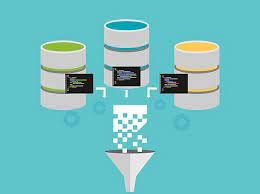

Loading the data after all the pre-processing we have performed to answer our original research question - 

## **There is a correlation between the crime to the housing market in Chicago?**

In [8]:
df_crime = pd.read_csv('/content/drive/MyDrive/crimes_2015_to_present_with_neigh.csv')
df_market = pd.read_csv('/content/drive/MyDrive/chicago_market_filtered_with_normalized_neigh.csv')

We would like to aggregate the data by date, therefore we will create the relevant column

In [9]:
def create_data_columns(df, column_name):
  df['Date'] = df[column_name + '_month'].astype(str) + "/" + df[column_name + '_day'].astype(str) + "/" + df[column_name + '_year'].astype(str) 
  df['Date'] = pd.to_datetime(df['Date'])

def create_date_column_market(df, column_name):
  df['Date'] = df[column_name + '_month'].astype(str) + "/" + df[column_name + '_day'].astype(str) + "/" + df[column_name + '_year'].astype(str) 
  df['Date'] = pd.to_datetime(df['Date'])

if 'Date' not in list(df_crime.columns):
  create_data_columns(df_crime, 'Date')

create_data_columns(df_market, 'period_begin') 

Now we can perform grouping by periods of months so both dataframes will be aligned

In [10]:
df_crime["Date_timestamp"] = pd.to_datetime(df_crime["Date"])
df_crime = df_crime[df_crime['Name'] != ""]
group_by_counts_crime = df_crime.groupby(['Name', df_crime['Date_timestamp'].dt.to_period('M')],as_index=False).size()
group_by_counts_crime["Date_timestamp"] = group_by_counts_crime["Date_timestamp"].dt.to_timestamp()

In [11]:
df_market["Date_timestamp"] = pd.to_datetime(df_market["Date"])
df_market = df_market[df_market['Name'] != ""]
df_market = df_market[df_market['period_end_year'] >= 2015]
group_by_counts_market = df_market.groupby(['Name', df_market['Date_timestamp']],as_index=False).agg({"new_listings": "sum", "homes_sold": "sum", "geometry":"first"})
group_by_counts_market['new_listings'] = group_by_counts_market['new_listings']/max(group_by_counts_market['new_listings'])

Merging both dataframes over the name of the neighbourhod and month

In [12]:
merged_market_crime = group_by_counts_crime.merge(group_by_counts_market, on=['Date_timestamp', 'Name'], how='left')

In [13]:
merged_market_crime

,Name,Date_timestamp,size,new_listings,homes_sold,geometry
0,Albany Park,2015-01-01,207,0.077847,341.0,POINT (-87.71928749999999 41.9538222)
1,Albany Park,2015-02-01,207,0.091364,381.0,POINT (-87.7280279 41.9683269)
2,Albany Park,2015-03-01,250,0.105257,471.0,POINT (-87.71928749999999 41.9538222)
3,Albany Park,2015-04-01,190,0.111389,526.0,POINT (-87.71928749999999 41.9538222)
4,Albany Park,2015-05-01,258,0.108385,621.0,POINT (-87.71928749999999 41.9538222)
...,...,...,...,...,...,...
18767,Wrigleyville,2021-08-01,52,0.004255,28.0,POINT (-87.656516 41.949062)
18768,Wrigleyville,2021-09-01,69,NaN,NaN,NaN
18769,Wrigleyville,2021-10-01,41,NaN,NaN,NaN
18770,Wrigleyville,2021-11-01,33,NaN,NaN,NaN


# **The impact of crime on the housing market**

Following our map visualizations in the previous section we selected to focus on the following neighboors to understand deeply what was the reason behind the price change.

However we decided it will be more accurate to check this statistically by pearson test, therefore, we will iterate over all the neighbourhods and find those that have an absoulute correlation that is higher than 0.45.

We will focus on the **new listings** and the amount of **homes that were sold**.

In [5]:
def check_corr(data, threshold = 0.45):
  neigh_discover = []
  for neigh_name in data['Name'].unique():
    merged_filtered = data[data['Name'] == neigh_name]
    correlation = merged_filtered.corr(method="pearson")
    if correlation['new_listings']['size'] >threshold or correlation['homes_sold']['size'] > threshold or correlation['new_listings']['size'] < -threshold or correlation['homes_sold']['size'] < -threshold:
      neigh_discover.append(neigh_name)
      print(neigh_name)
      print(correlation)
      f, ax = plt.subplots(figsize =(9, 8))
      ax.set_title(neigh_name)
      sns.heatmap(correlation, ax = ax, cmap ="YlGnBu", linewidths = 0.1)
      sns.pairplot(merged_filtered, kind="scatter")
      plt.show()
  return neigh_discover

Get neighborhood name and get only the relevant records from the df and plot the trends of crime, homes sold and new listings.

In [6]:
def plot_comaprison(df_market_grouped, df_crime_grouped, neigh_name, scatter):
  df_market_grouped = df_market_grouped[df_market_grouped['Name'] == neigh_name]
  df_market_grouped['new_listings'] = df_market_grouped['new_listings'] / max(df_market_grouped['new_listings'])
  df_market_grouped = df_market_grouped[df_market_grouped['Name'] == neigh_name]
  df_market_grouped['homes_sold'] = df_market_grouped['homes_sold'] / max(df_market_grouped['homes_sold'])
  df_crime_grouped = df_crime_grouped[df_crime_grouped['Name'] == neigh_name]
  df_crime_grouped['size'] = df_crime_grouped['size'] / max(df_crime_grouped['size'])
  fig = px.scatter(df_market_grouped, x="Date_timestamp", y="new_listings", trendline="lowess").update_traces(
    marker={"color": "red"}, name="Market new listings trend", showlegend=True
  ).add_traces(
      px.scatter(df_market_grouped, x="Date_timestamp", y="homes_sold", trendline="lowess")
      .update_traces(marker={"color": "green"}, name="Market homes sold trend", showlegend=True)
      .data
  ).add_traces(
      px.scatter(df_crime_grouped, x="Date_timestamp", y="size", trendline="lowess")
      .update_traces(marker={"color": "blue"}, name="Crime trend", showlegend=True)
      .data
  )
  fig.update_layout(
    title=f"Market & Crime comparison in {neigh_name}")
  if scatter:
    fig.data = [t for t in fig.data if t.mode == "lines"]
  fig.show()

Brighton Park
                  size  new_listings  homes_sold
size          1.000000      0.480415    0.382115
new_listings  0.480415      1.000000    0.295204
homes_sold    0.382115      0.295204    1.000000


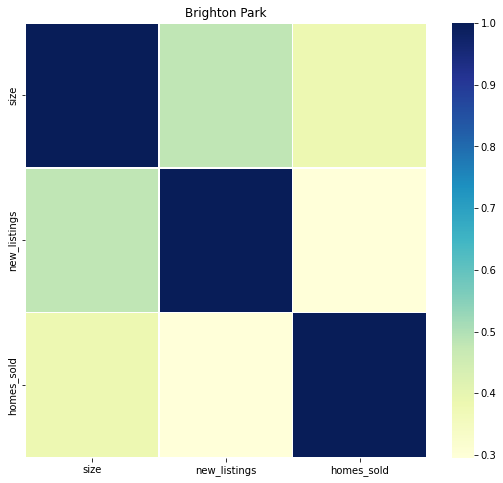

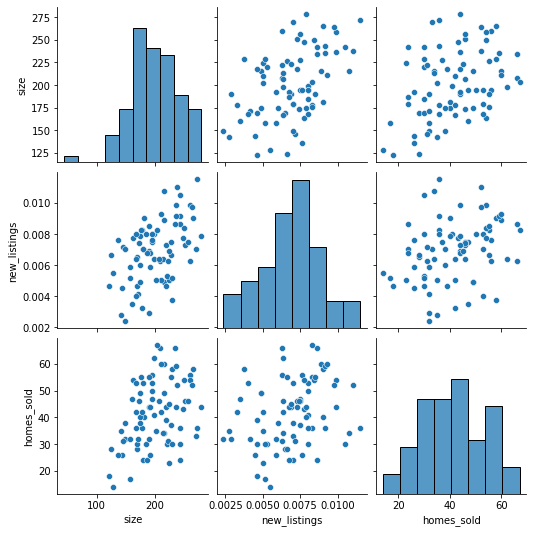

Bucktown
                  size  new_listings  homes_sold
size          1.000000     -0.508616   -0.343616
new_listings -0.508616      1.000000    0.688862
homes_sold   -0.343616      0.688862    1.000000


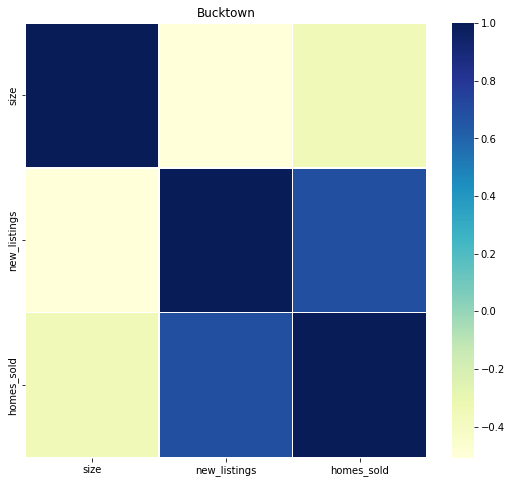

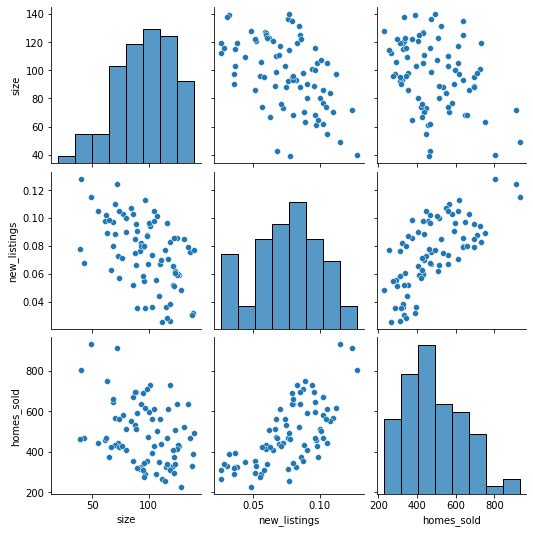

Illinois Medical District
                  size  new_listings  homes_sold
size          1.000000      0.394851   -0.863737
new_listings  0.394851      1.000000   -0.500000
homes_sold   -0.863737     -0.500000    1.000000


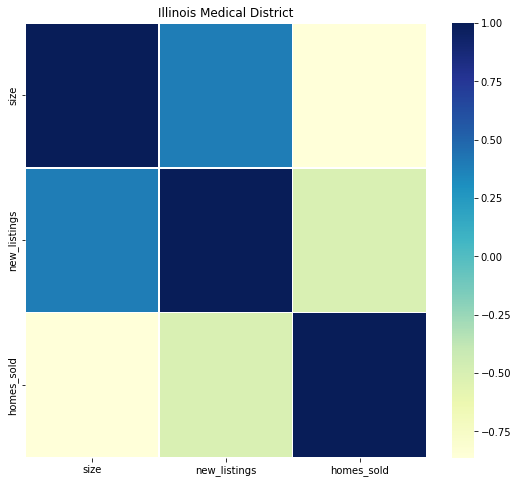

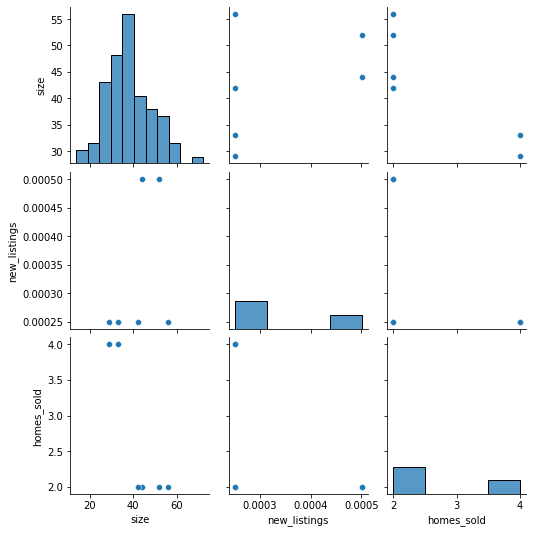

Lake View
                  size  new_listings  homes_sold
size          1.000000     -0.473780   -0.135609
new_listings -0.473780      1.000000    0.685458
homes_sold   -0.135609      0.685458    1.000000


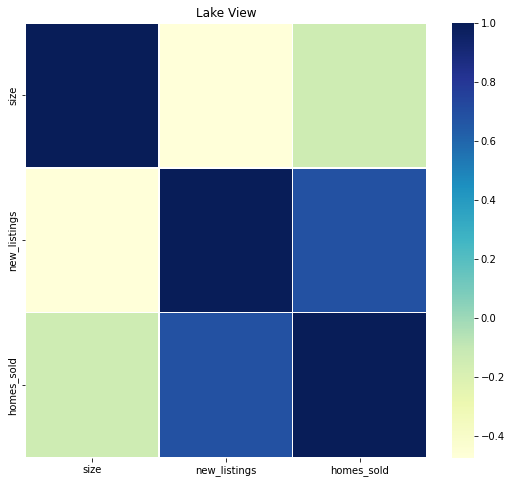

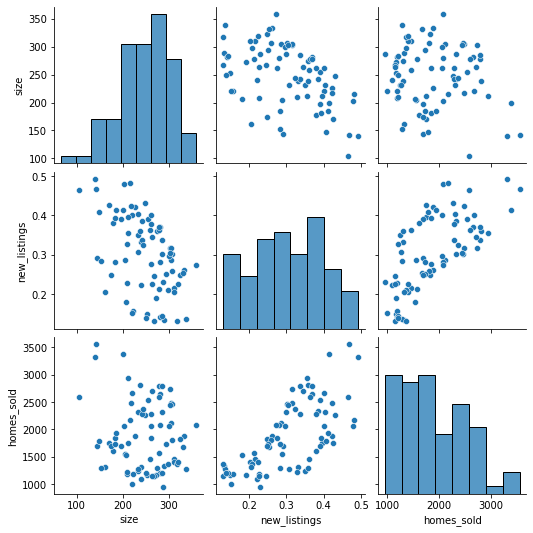

Marquette Park
                  size  new_listings  homes_sold
size          1.000000      0.508426    0.409372
new_listings  0.508426      1.000000    0.424575
homes_sold    0.409372      0.424575    1.000000


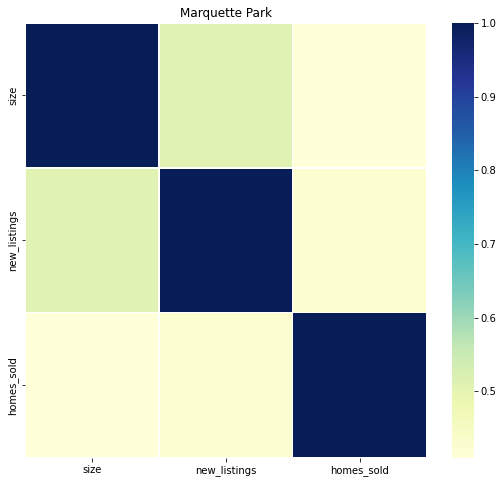

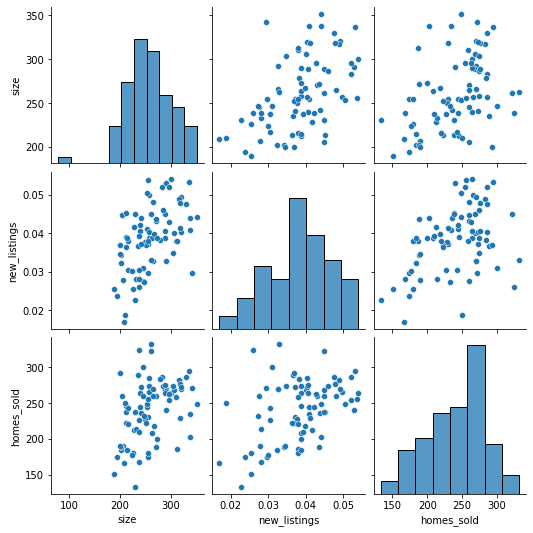

Palmer Square
                  size  new_listings  homes_sold
size          1.000000     -0.478005   -0.294660
new_listings -0.478005      1.000000    0.690326
homes_sold   -0.294660      0.690326    1.000000


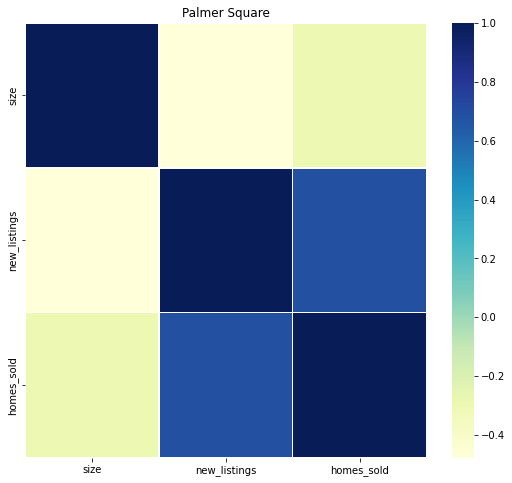

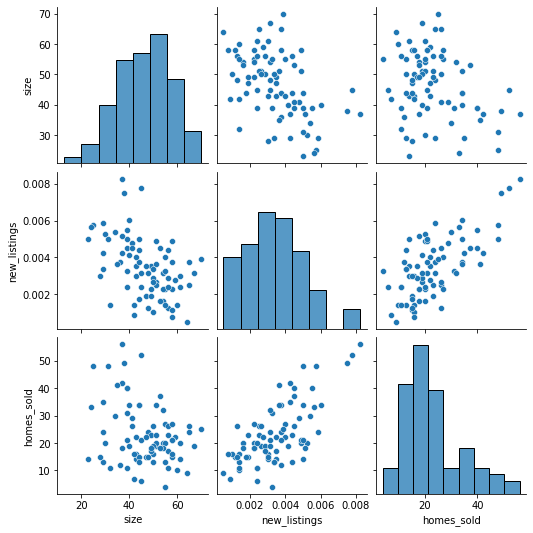

West Lawn
                  size  new_listings  homes_sold
size          1.000000      0.444330    0.460843
new_listings  0.444330      1.000000    0.637301
homes_sold    0.460843      0.637301    1.000000


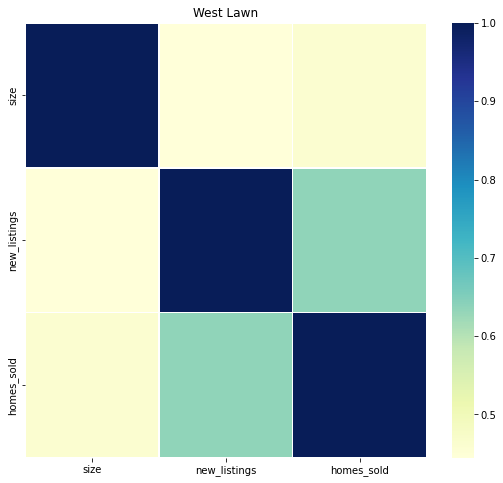

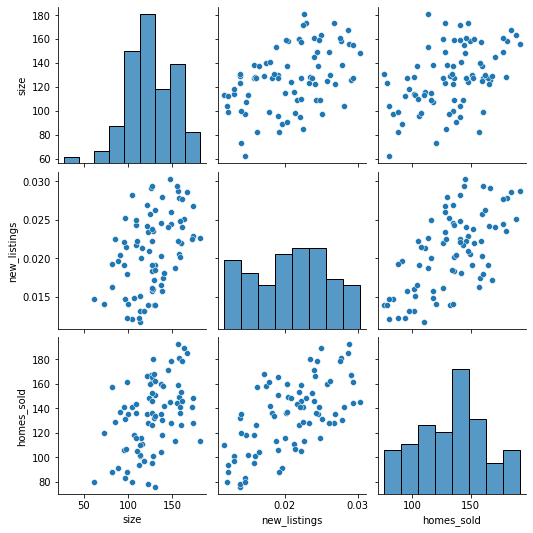

In [14]:
neigh_discover = check_corr(merged_market_crime)

Plot the trends for all the neighborhoods with high correlation

In [15]:
for neig in neigh_discover:
  plot_comaprison(group_by_counts_market, group_by_counts_crime, neig, True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## **Graphs analysis:**

*   **Brighton Park**

  We can see from this graph that the correlation is positive which means that once the crime amount is decreasing so as the number of new listings and homes sold.

  We See that it started to happen since 2017 that the amount of new listings and homes sold is decrasing and we assume it might be due to the fact the neighborhood crime is not hurting them so much and therefore, they are not trying to sell their houses.

*   **Bucktown**

  In opposite to the previous neighborhood here we an increase in new listings and homes sold one year and a half - Janurary 2019, after we see that the crime started to decrease - April 2017. 

  This time we assume it happened since pepole started to see that is neighborhood is safer and therefore, there was an increase in new listings and homes sold.


*   **Illinois Medical District**

  We decided to ignore this one since the collected data on the housing market is not complete.

*   **Lake View**

  Same as Bucktown neighborhood, we see an increase in new listings and homes sold when the crime started to decrease, this time it took around 2 years - from Jan 2017 to Jan 2019.


*   **Marquette Park**

  Same explanation as Brighton Park.

*   **Palmer Square**

  This graph is a bit different than the others since we don't see a peak for one month, but we see couple of months with almost the same amount of crime from April 2017 to October 2018, and during this time there was an increase in the amount of new listings but not at the beginning it seems like they didn't manage to sell them. 
  
  Only around September 2018 we see an increase in amount of homes sold, we are not sure if this led to the crime decrease or the opposite but it's really interesting to see this trend.

*   **West Lawn**

  Same explanation as Brighton Park.

In [16]:
neigh_discover_df = merged_market_crime[merged_market_crime['Name'].isin(neigh_discover)]
neigh_discover_df['Date'] = list(map(str,neigh_discover_df['Date_timestamp']))
neigh_discover_df=neigh_discover_df.dropna()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
def plot_year(axis_y, title):
  import plotly.express as px
  fig = px.bar(neigh_discover_df, x="Name", y=axis_y, color="Name",
    animation_frame="Date",range_y=[0,max(neigh_discover_df[axis_y])], title=title)
  fig.show()

In [18]:
plot_year("size",  "Crime over years")

In [19]:
plot_year("homes_sold",  "homes sold over years")

In [20]:
plot_year("new_listings",  "new listings over years")

In [23]:
import shapely
from shapely.wkt import dumps, loads
neigh_discover_df['geometry'] = list(map(shapely.wkt.loads, neigh_discover_df['geometry']))

/usr/local/lib/python3.7/dist-packages/pandas/core/dtypes/cast.py:118: ShapelyDeprecationWarning:

The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.



In [24]:
neigh_discover_df['lon'] =neigh_discover_df.geometry.apply(lambda p: p.x)
neigh_discover_df['lat'] =neigh_discover_df.geometry.apply(lambda p: p.y)

In [33]:
fig = px.scatter_mapbox(
    neigh_discover_df, lat="lat", lon="lon", color="size", size="homes_sold",
    hover_name='Name', hover_data=['Name'], zoom=12, size_max=20, animation_frame="Date")
fig.update_layout(mapbox_style="light", mapbox_accesstoken='pk.eyJ1Ijoic2hpcjA1IiwiYSI6ImNsMDEzanp2ZjAweTQzY21rdDFrOXFnbXAifQ.q_VcBsMVbV1mRvyqfINjFg')
fig.show(
    config={
        'displayModeBar': False,
        'editable': False,
    },
)

In [ ]:
neigh_discover_df

In [62]:
import plotly.graph_objects as px

for negih in neigh_discover:
  new = neigh_discover_df[neigh_discover_df['Name'] == negih]
  neigh_discover_df_ = new.groupby('Date', as_index=False).sum()
  plot = px.Figure(data=[go.Bar(
      name='homes_sold',
      x=neigh_discover_df_['Date'],
      y=neigh_discover_df_['homes_sold']),
      go.Bar(
      name='crime',
      x=neigh_discover_df_['Date'],
      y=neigh_discover_df_['size']), 
          go.Bar(
      name='new_listings',
      x=neigh_discover_df_['Date'],
      y=neigh_discover_df_['new_listings']*5000)
      
      ])
    
    
  # Add dropdown
  plot.update_layout(title=negih, 
      updatemenus=[
          dict(
              type="buttons",
              direction="left",
              buttons=list([
                  dict(label="All",
                      method="update",
                      args=[{"visible": [True, True, True]},
                            {"title": "All"}]),
                  dict(label="homes_sold",
                      method="update",
                      args=[{"visible": [True, False, False]},
                            {"title": "homes_sold",
                              }]),
                  dict(label="crime",
                      method="update",
                      args=[{"visible": [False, True, False]},
                            {"title": "crime",
                              }]),
                  dict(label="new_listings",
                      method="update",
                      args=[{"visible": [False, False, True]},
                            {"title": "new_listings",
                              }]),
                  dict(label="new_listings and crime",
                      method="update",
                      args=[{"visible": [False, True, True]},
                            {"title": "new_listings",
                              }]),
                  dict(label="homes_sold and crime",
                      method="update",
                      args=[{"visible": [True, True, False]},
                            {"title": "new_listings",
                              }]),
              ]),
          )
      ])
    
  plot.show()

# **Save as html**

In [170]:
%%shell
jupyter nbconvert --to html Project_housing.ipynb

[NbConvertApp] Converting notebook Project_housing.ipynb to html
/usr/local/lib/python2.7/dist-packages/nbconvert/filters/datatypefilter.py:41: UserWarning: Your element with mimetype(s) [u'application/vnd.colab-display-data+json'] is not able to be represented.
  mimetypes=output.keys())
[NbConvertApp] Writing 22621263 bytes to Project_housing.html
